# NEURAL NETWORKS AND DEEP LEARNING

---
A.A. 2024/25 (6 CFU) - Prof. Michele Rossi, Prof. Jacopo Pegoraro, Dr. Gianmaria Ventura, Dr. Pietro Talli
---


## Lab. 05 - Convolutional Autoencoder

An autoencoder, in general, is a network that is trained to attempt to copy its input to its output. Internally, it has a **latent space** that describes a code used to represent the input. The network may be viewed as consisting of two parts: an **encoder** function $h=f(x)$ and a **decoder** that produces a reconstruction $r=g(h)$.

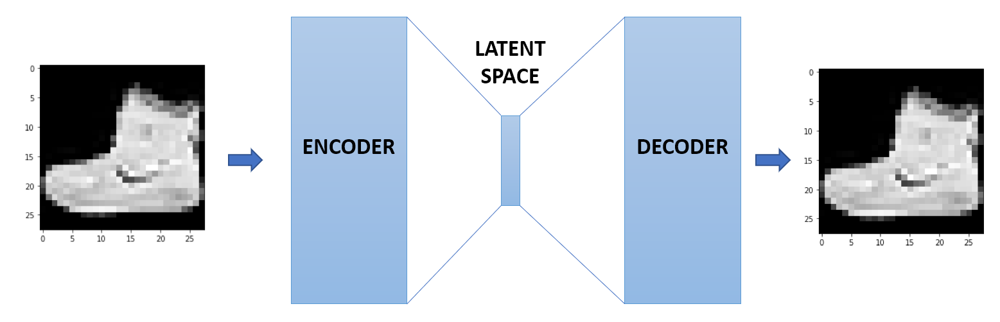

The learning process is described simply as minimizing a loss function $L(x, g(f(x)))$, where $L$ is a loss function penalizing $g(f(x))$ for being dissimilar from $x$, such as the mean squared error.

While the learning is considered to be **unsupervised** since we are using only the value of $x$, the actual implementation is similar to a supervised setting where the label is just derived from the input.

In [1]:
import matplotlib.pyplot as plt # plotting library
import numpy as np # this module is useful to work with numerical arrays
import pandas as pd # this module is useful to work with tabular data
import random # this module will be used to select random samples from a collection
import os # this module will be used just to create directories in the local filesystem
from tqdm import tqdm # this module is useful to plot progress bars

import torch
import torchvision
from torchvision import transforms
from torch.utils.data import DataLoader
from torch import nn

# Dataset

## Define the dataset

For this lab. we will use one of the dataset already included in PyTorch ([https://pytorch.org/vision/stable/datasets.html](https://pytorch.org/vision/stable/datasets.html)).

**NOTE:** These dataset do not require the definition of a custom `Dataset` class, so we can focus on the network implementation.

The Fashion MNIST dataset is a colletion of Zalando's article images. The size of the images is $28 \times 28$, and there is a single channel only (black and white images) with 10 classes.

In [2]:
### Download the data and create dataset
data_dir = 'dataset'
# With these commands the train and test datasets, respectively, are downloaded
# automatically and stored in the local "data_dir" directory.
train_dataset = torchvision.datasets.FashionMNIST(data_dir, train=True, download=True)
test_dataset  = torchvision.datasets.FashionMNIST(data_dir, train=False, download=True)

The output of the dataset is a PIL Image, a standard format for image processing, but we can easily convert the data to a numpy array:
```
image_numpy = np.array(pil_image)
```
or to a PyTorch tensor:
```
to_tensor = torchvision.transforms.ToTensor()
image_tensor = to_tensor(pil_image)
```


Let's plot some random samples from the dataset. The first element of the sample is the actual image, while the second is the corresponding label.

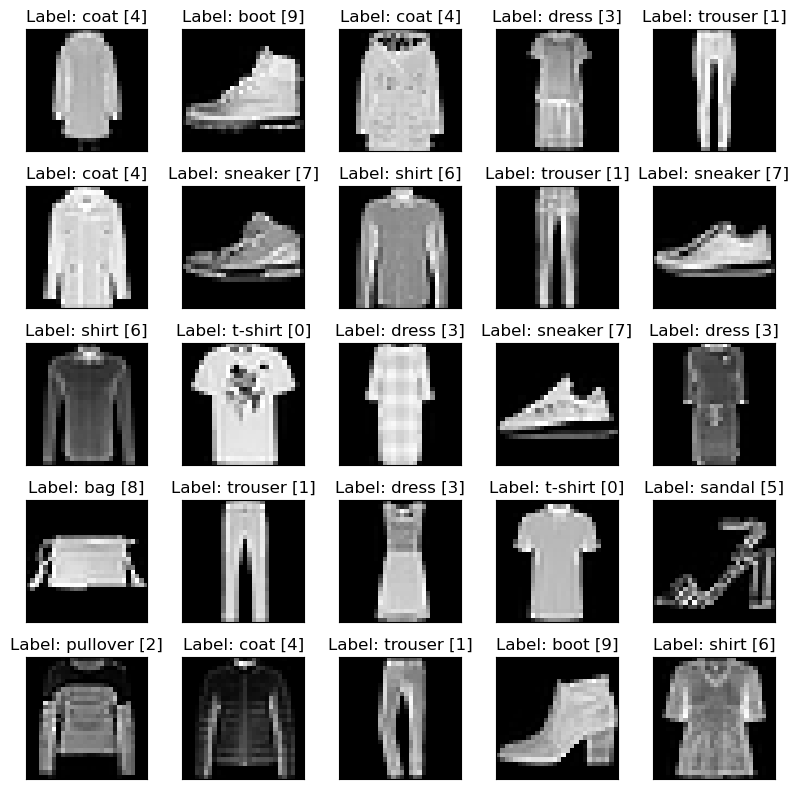

In [3]:
### Plot some sample
label_names=['t-shirt','trouser','pullover','dress','coat','sandal','shirt',
             'sneaker','bag','boot']
fig, axs = plt.subplots(5, 5, figsize=(8,8))
for ax in axs.flatten():
    # random.choice allows to randomly sample from a list-like object (basically anything that can be accessed with an index, like our dataset)
    img, label = random.choice(train_dataset)
    ax.imshow(np.array(img), cmap='gist_gray')
    ax.set_title(f'Label: {label_names[label]} [{label}]')
    ax.set_xticks([])
    ax.set_yticks([])
plt.tight_layout()

## Define the dataset transform

In this example we are using the input images without any modification. As always, the only requirement is to transform the input data to tensors of the proper shape.

In [4]:
# In this case the train_transform and test_transform are the same,
# but we keep them separate for potential future updates
train_transform = transforms.Compose([
    transforms.ToTensor(),
])
test_transform = transforms.Compose([
    transforms.ToTensor(),
])


Since we already defined our datasets, this is an alternative (and recommended) way to add (or modify) a dataset transformation without reinitializing the dataset (very useful when the dataset initialization is slow):

In [5]:
# check what is going on BEFORE the transformation is in place!
print("Dataset info:")
print(train_dataset)
print("First sample:")
print(train_dataset[0])
print("First sample x value (image):")
print(train_dataset[0][0])
print("First sample y value (label):")
print(train_dataset[0][1])

Dataset info:
Dataset FashionMNIST
    Number of datapoints: 60000
    Root location: dataset
    Split: Train
First sample:
(<PIL.Image.Image image mode=L size=28x28 at 0x7B7D7AF30A50>, 9)
First sample x value (image):
<PIL.Image.Image image mode=L size=28x28 at 0x7B7D7AF30A50>
First sample y value (label):
9


In [6]:
# Set the train transform
train_dataset.transform = train_transform
# Set the test transform
test_dataset.transform = test_transform

In [7]:
# check what is going on AFTER the transformation is in place!
print("Dataset info:")
print(train_dataset)
print("First sample:")
print(train_dataset[0])
print("First sample x value (image):")
print(train_dataset[0][0])
print("First sample y value (label):")
print(train_dataset[0][1])

Dataset info:
Dataset FashionMNIST
    Number of datapoints: 60000
    Root location: dataset
    Split: Train
First sample:
(tensor([[[0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
          0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
          0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
          0.0000, 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
          0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
          0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
          0.0000, 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
          0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
          0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
          0.0000, 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
     

## Define the dataloader

The dataloader allows to easily create batch of data, in this case we set a batch size of 256, and we also enable data shuffling for the training dataset.

In [8]:
### Define train dataloader
train_dataloader = DataLoader(train_dataset, batch_size=256, shuffle=True)
### Define test dataloader
test_dataloader = DataLoader(test_dataset, batch_size=256, shuffle=False)

# Plot two batch.
batch_data, batch_labels = next(iter(train_dataloader))
print(f"TRAIN BATCH SHAPE")
print(f"\t Data: {batch_data.shape}")
print(f"\t Labels: {batch_labels.shape}")

batch_data, batch_labels = next(iter(test_dataloader))
print(f"TEST BATCH SHAPE")
print(f"\t Data: {batch_data.shape}")
print(f"\t Labels: {batch_labels.shape}")

TRAIN BATCH SHAPE
	 Data: torch.Size([256, 1, 28, 28])
	 Labels: torch.Size([256])
TEST BATCH SHAPE
	 Data: torch.Size([256, 1, 28, 28])
	 Labels: torch.Size([256])


# Autoencoder

## Encoder

Let's start from the encoder. In the figure you can find a suggested architecture for the encoder, with all the required parameters for each layer.

In this example we are considering a latent space with just **2 variables**, so make sure your encoder generates tensors with the proper shape.

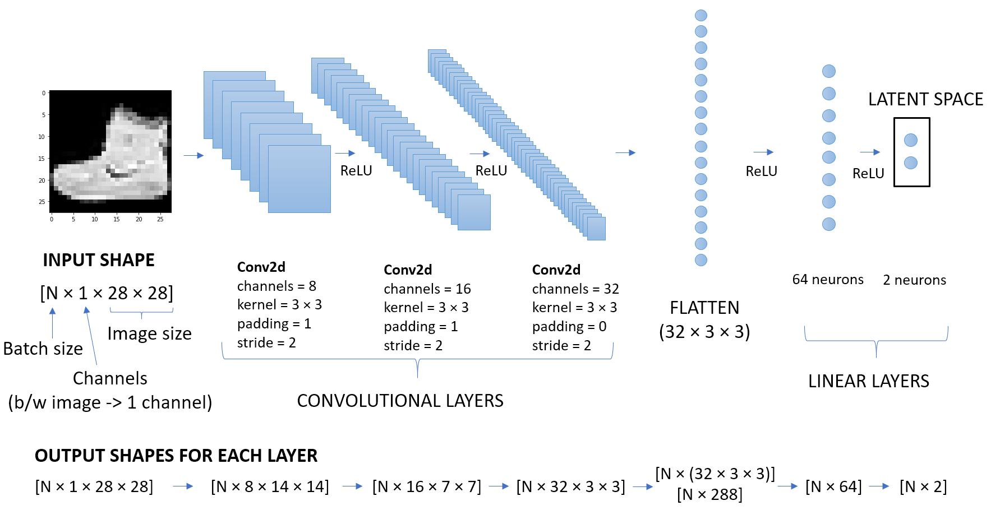

`torch.nn.Sequential` is a utility function that allows to easily concatenate sequential layers, without defining a separate object for each of them (more details here: [torch.nn.Sequential](https://pytorch.org/docs/stable/generated/torch.nn.Sequential.html)).

The output of a convolutional layer is typically multi-dimensional. To apply a linear layer after a convolutional one you should convert your tensor to a monodimensional array. This operation is often referred to as **flattening**. In PyTorch, this can be done with the [`torch.nn.Flatten`](https://pytorch.org/docs/stable/generated/torch.nn.Flatten.html?highlight=flatten#torch.nn.Flatten)
 layer. By setting `start_dim = 1` we keep the first axis (index 0) as it is (which represents the batch size in our case, that should not be flattened) and all the other axes will be flattened in the new second axis.

In [9]:
class Encoder(nn.Module):

    def __init__(self, encoded_space_dim):
        super().__init__()

        ### Convolutional section
        self.encoder_cnn = nn.Sequential(
            nn.Conv2d(1, 8, kernel_size=3, padding=1, stride=2),
            nn.ReLU(),
            nn.Conv2d(8, 16, kernel_size=3, padding=1, stride=2),
            nn.ReLU(),
            nn.Conv2d(16, 32, kernel_size=3, padding=0, stride=2),
            nn.ReLU()
        )

        ### Flatten layer
        ### These layers can't be placed inside Sequential layers and should be
        ### applied in the forward function
        self.flatten = nn.Flatten(start_dim=1) # Because we do no want to flatten the batch size.

        ### Linear section
        self.encoder_lin = nn.Sequential(
            nn.Linear(32 * 3 * 3, 64),
            nn.ReLU(),
            nn.Linear(64, encoded_space_dim)
        )

    def forward(self, x):
        x = self.encoder_cnn(x)
        x = self.flatten(x)
        x = self.encoder_lin(x)
        return x

In [10]:
x = torch.zeros(1, 1, 28, 28)
model = Encoder(2)
model(x).shape

torch.Size([1, 2])

## Decoder

Typically the structure of the decoder is specular with respect to the encoder, but this is not a strict requirement. Some successful implementations use very different architectures for the encoder and the decoder.

The only requirement of the decoder is the input shape, which must match the latent space, and the output shape, that must match the input image.

In this example we implement a decoder perfectly matched with the encoder architecture, but reversed.

Since the convolutional layers in the encoder perform a down-scaling, we need up-scaling layers in the decoder. To this end we use **transposed convolutions**, already available in PyTorch with the [`torch.nn.ConvTranspose2d`](https://pytorch.org/docs/stable/generated/torch.nn.ConvTranspose2d.html) layer.

Similarly to the `torch.nn.Flatten` layer, the [`torch.nn.Unflatten`](https://pytorch.org/docs/stable/generated/torch.nn.Unflatten.html?highlight=unflatten#torch.nn.Unflatten) layer does the opposite operation. We take the axis at index 1 (`dim=1`) and we reshape it to the proper shape (`unflattened_size=(32, 3, 3)`).

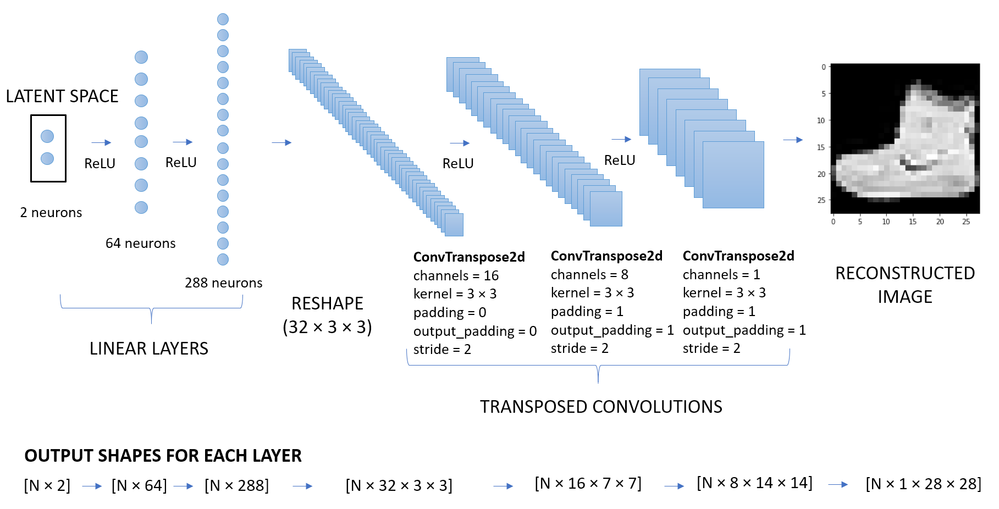

Inputs with different sizes can lead to outputs of the same size

In [11]:
input_t = torch.ones(1, 3, 5, 5)
conv = nn.Conv2d(in_channels=3, out_channels=8, kernel_size=3, stride=2)
print(f"Input size: {input_t.shape} Output size:{conv(input_t).shape}")


input_t = torch.ones(1, 3, 6, 6)
print(f"Input size: {input_t.shape} Output size:{conv(input_t).shape}")

Input size: torch.Size([1, 3, 5, 5]) Output size:torch.Size([1, 8, 2, 2])
Input size: torch.Size([1, 3, 6, 6]) Output size:torch.Size([1, 8, 2, 2])


In the decoder the correct output size can be obtained by specifying the `output_padding` parameter

In [12]:
input_t = torch.ones(1, 8, 2, 2)
conv_zero_out_pad = nn.ConvTranspose2d(in_channels=8, out_channels=3, kernel_size=3, stride=2, output_padding=0)
print(f"Input size: {input_t.shape} Output size:{conv_zero_out_pad(input_t).shape}")

conv_out_pad = nn.ConvTranspose2d(in_channels=8, out_channels=3, kernel_size=3, stride=2, output_padding=1)
print(f"Input size: {input_t.shape} Output size:{conv_out_pad(input_t).shape}")

Input size: torch.Size([1, 8, 2, 2]) Output size:torch.Size([1, 3, 5, 5])
Input size: torch.Size([1, 8, 2, 2]) Output size:torch.Size([1, 3, 6, 6])


In [13]:
class Decoder(nn.Module):

    def __init__(self, encoded_space_dim):
        super().__init__()

        ### Linear section
        self.decoder_lin = nn.Sequential(
            nn.Linear(encoded_space_dim, 64),
            nn.ReLU(),
            nn.Linear(64, 288),
            nn.ReLU(),
        )

        ### Unflatten
        self.unflatten = nn.Unflatten(1, (32, 3, 3))

        ### Convolutional section
        self.decoder_conv = nn.Sequential(
            nn.ConvTranspose2d(32, 16, kernel_size=3, padding=0, output_padding=0, stride=2),
            nn.ReLU(),
            nn.ConvTranspose2d(16, 8, kernel_size=3, padding=1, output_padding=1, stride=2),
            nn.ReLU(),
            nn.ConvTranspose2d(8, 1, kernel_size=3, padding=1, output_padding=1, stride=2)
        )

    def forward(self, x):
        x = self.decoder_lin(x)
        x = self.unflatten(x)
        x = self.decoder_conv(x)
        x = torch.sigmoid(x)
        return x

In [14]:
x = torch.zeros(1, 2)
model = Decoder(2)
model(x).shape

torch.Size([1, 1, 28, 28])

Initialize the two networks.

In [15]:
### Set the random seed for reproducible results
torch.manual_seed(0)

### Initialize the two networks
encoded_space_dim = 2
encoder = Encoder(encoded_space_dim=encoded_space_dim)
decoder = Decoder(encoded_space_dim=encoded_space_dim)

Let's check if all the shapes are correct.

In [16]:
### Some examples
# Take an input image (remember to add the batch dimension)
img, _ = test_dataset[0]
img = img.unsqueeze(0) # Add the batch dimension in the first axis
print('Original image shape:', img.shape)
# Encode the image
img_enc = encoder(img)
print('Encoded image shape:', img_enc.shape)
# Decode the image
dec_img = decoder(img_enc)
print('Decoded image shape:', dec_img.shape)

Original image shape: torch.Size([1, 1, 28, 28])
Encoded image shape: torch.Size([1, 2])
Decoded image shape: torch.Size([1, 1, 28, 28])


# Training

The training is similar to the previous examples. The only difference is that now we have 2 different networks. In this situation you have 2 choices:
*   Use a single optimizer to train the parameters of both networks.
*   Define a separate optimizer for each network, and update both of them in the training loop.

In this case we define a single optimizer for both networks, by just providing a list of the required parameters to the optimizer (see the code below).

You can find more details for all the possible scenarios [here](https://pytorch.org/docs/stable/optim.html).

In [17]:
### Define the loss function
loss_fn = torch.nn.MSELoss()

### Define an optimizer (both for the encoder and the decoder!)
lr = 5e-4 # Learning rate
params_to_optimize = [
    {'params': encoder.parameters()},
    {'params': decoder.parameters()}
]
optim = torch.optim.Adam(params_to_optimize, lr=lr, weight_decay=1e-5)

# Check if the GPU is available
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(f'Selected device: {device}')

# Move both the encoder and the decoder to the selected device
encoder.to(device)
decoder.to(device)

Selected device: cuda


Decoder(
  (decoder_lin): Sequential(
    (0): Linear(in_features=2, out_features=64, bias=True)
    (1): ReLU()
    (2): Linear(in_features=64, out_features=288, bias=True)
    (3): ReLU()
  )
  (unflatten): Unflatten(dim=1, unflattened_size=(32, 3, 3))
  (decoder_conv): Sequential(
    (0): ConvTranspose2d(32, 16, kernel_size=(3, 3), stride=(2, 2))
    (1): ReLU()
    (2): ConvTranspose2d(16, 8, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), output_padding=(1, 1))
    (3): ReLU()
    (4): ConvTranspose2d(8, 1, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), output_padding=(1, 1))
  )
)

## Training function

For a cleaner and more reusable code, we define a training and a testing funcion. This will make the training loop more compact and readable.

The function will train (and test) the network just **for a single epoch**.

In this case, we just track the training loss for each batch. If you want the training loss for the entire epoch, you have to concatenate all the outputs (see the testing function as reference for this case).

In [18]:
### Training function
def train_epoch(encoder, decoder, device, dataloader, loss_fn, optimizer):
    # Set train mode for both the encoder and the decoder
    encoder.train()
    decoder.train()
    
    losses = []
    # Iterate the dataloader (we do not need the label values, this is unsupervised learning)
    for image_batch, _ in dataloader: # with "_" we just ignore the labels (the second element of the dataloader tuple)
        # Move data to device.
        image_batch = image_batch.to(device)

        # Zero the gradients.
        encoder.zero_grad()
        decoder.zero_grad()

        # Compute the out of the network.
        out = encoder(image_batch)
        out = decoder(out)

        # Compute the loss function.
        loss = loss_fn(out, image_batch)

        # Backpropagate.
        loss.backward()

        # Update weights.
        optimizer.step()

        # Save training loss.
        losses.append(loss.detach().cpu().numpy())
    losses = np.mean(losses)
    return losses

## Testing function

In this case, the testing function has the only goal to evaluate how well we are reproducing the input. We quantify this with the average MSE of the entire test set (which in this case correspond to our loss function, but this is not always true).

Since the entire dataset does not always fit in memory, this example shows how to evaluate the network output in batches, aggregating the results (using `conc_out` and `conc_label` in the code). At the end, you can evaluate a  single overall loss.

In [19]:
### Testing function
def test_epoch(encoder, decoder, device, dataloader, loss_fn):
    # Set evaluation mode for encoder and decoder
    encoder.eval()
    decoder.eval()
    with torch.no_grad(): # No need to track the gradients
        # Define the lists to store the outputs for each batch
        conc_out = []
        conc_label = []
        for image_batch, _ in dataloader:
            # Move tensor to the proper device
            image_batch = image_batch.to(device)
            
            # Encode data
            encoded_data = encoder(image_batch)
            
            # Decode data
            decoded_data = decoder(encoded_data)
            
            # Append the network output and the original image to the lists
            conc_out.append(decoded_data.cpu())
            conc_label.append(image_batch.cpu())
            
        # Create a single tensor with all the values in the lists
        conc_out = torch.cat(conc_out)
        conc_label = torch.cat(conc_label)
        # Evaluate global loss
        val_loss = loss_fn(conc_out, conc_label)
    return val_loss.data

## Training loop

Now that we have the training and testing functions, the training loop is considerably simplified. We just need to call these 2 functions for `num_epochs` times.

To see what happen during the training, we also show the output corresponding to a specific image at the end of each epoch.

EPOCH 1/20
TRAIN - EPOCH 1/20 - loss: 0.10423240065574646
VALIDATION - EPOCH 1/20 - loss: 0.06022646278142929



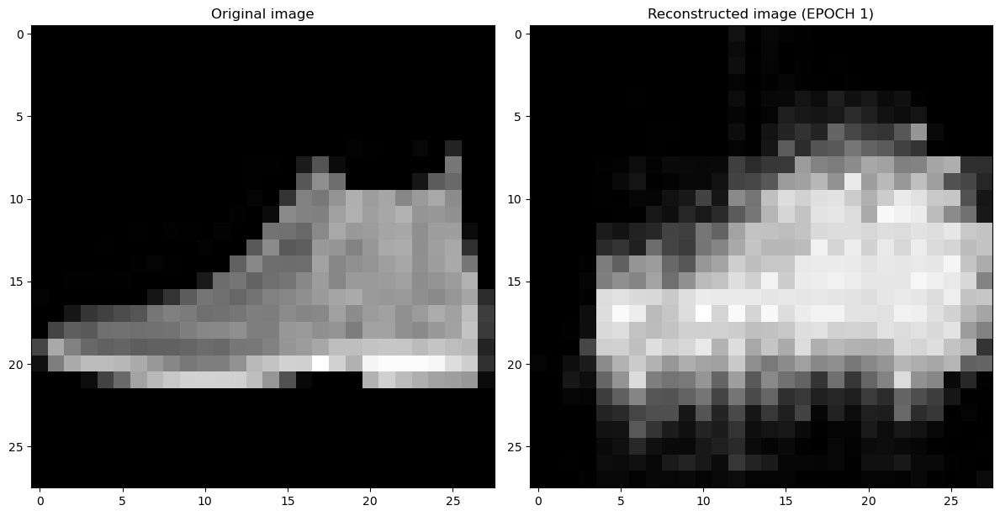

EPOCH 2/20
TRAIN - EPOCH 2/20 - loss: 0.04796842858195305
VALIDATION - EPOCH 2/20 - loss: 0.04060453549027443



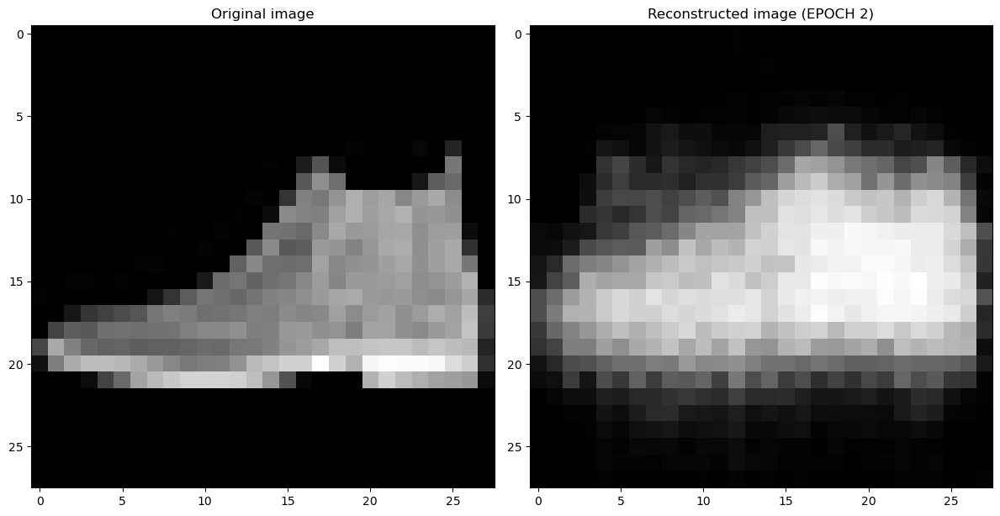

EPOCH 3/20
TRAIN - EPOCH 3/20 - loss: 0.03938254341483116
VALIDATION - EPOCH 3/20 - loss: 0.03805391117930412



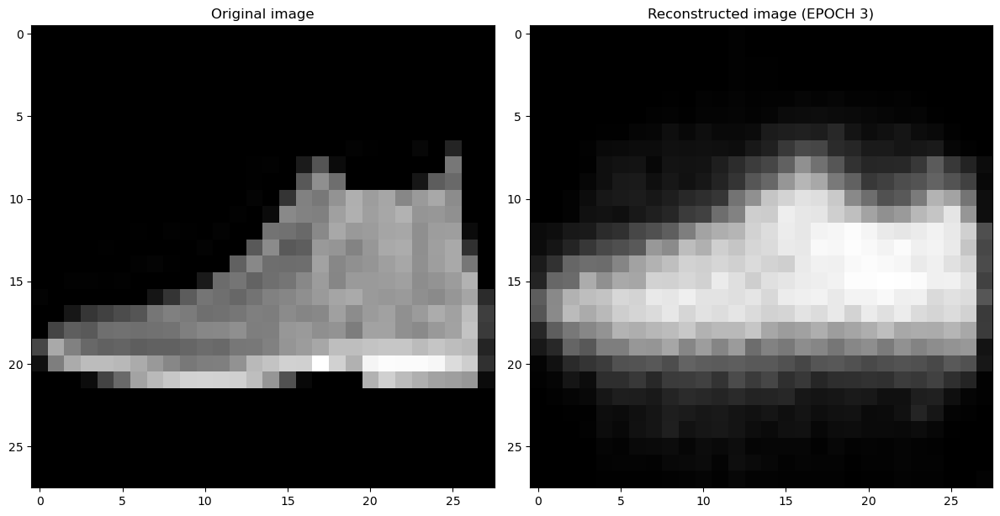

EPOCH 4/20
TRAIN - EPOCH 4/20 - loss: 0.037306953221559525
VALIDATION - EPOCH 4/20 - loss: 0.03631194308400154



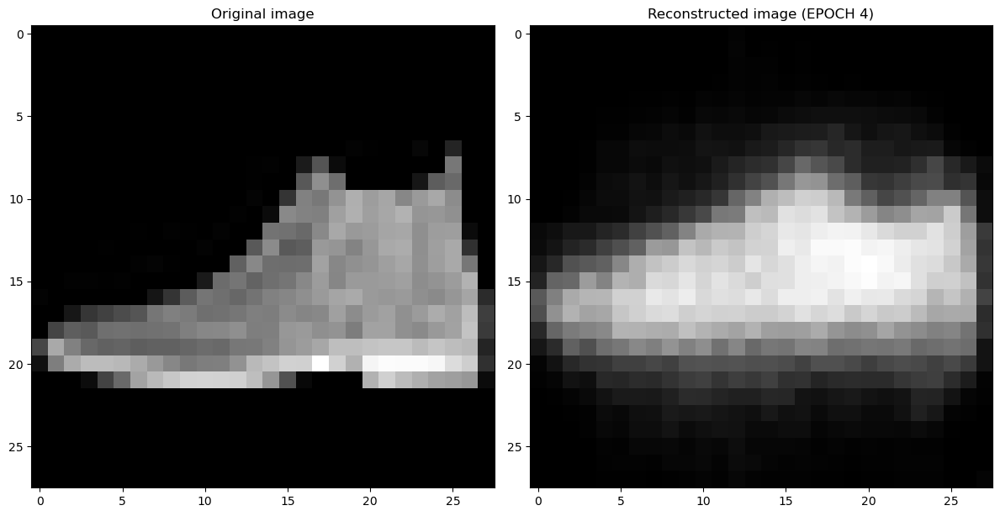

EPOCH 5/20
TRAIN - EPOCH 5/20 - loss: 0.035783808678388596
VALIDATION - EPOCH 5/20 - loss: 0.03497953712940216



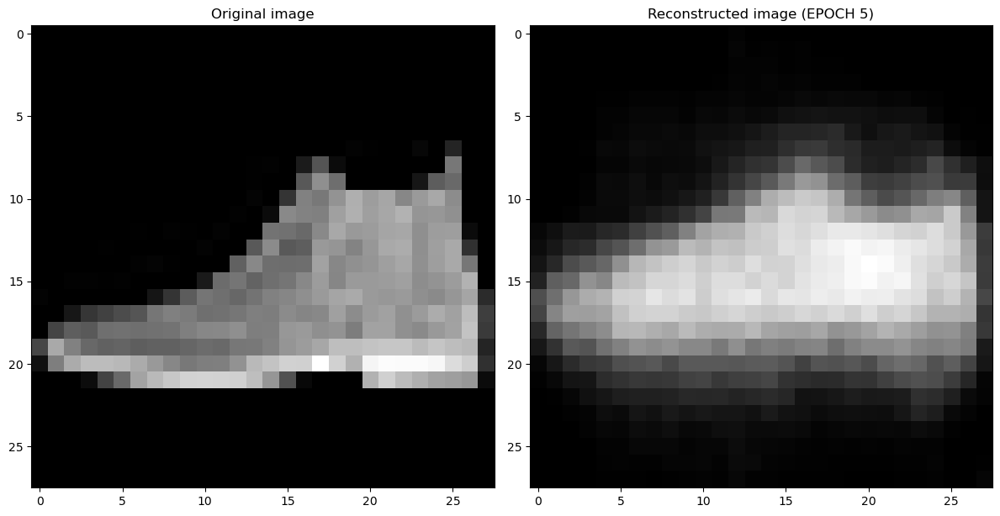

EPOCH 6/20
TRAIN - EPOCH 6/20 - loss: 0.03475777059793472
VALIDATION - EPOCH 6/20 - loss: 0.03408557176589966



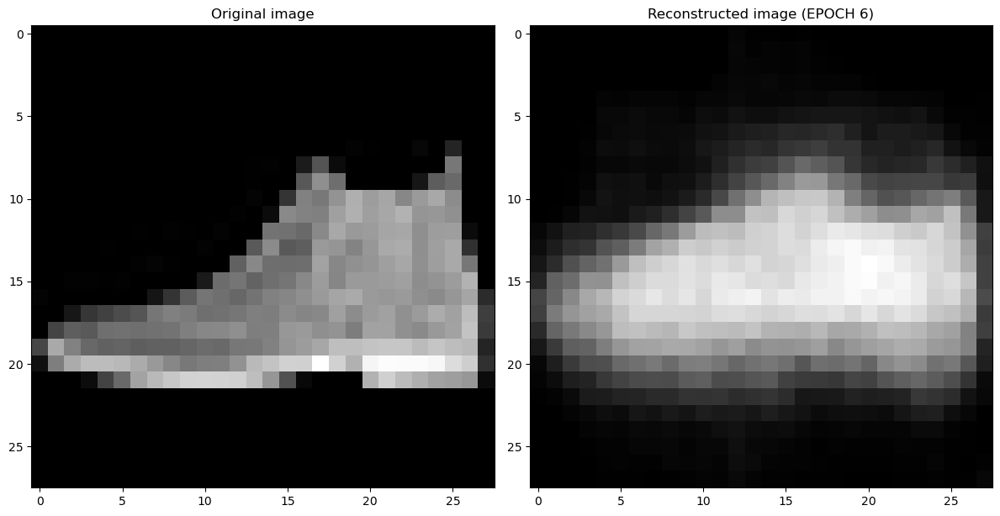

EPOCH 7/20
TRAIN - EPOCH 7/20 - loss: 0.034037794917821884
VALIDATION - EPOCH 7/20 - loss: 0.033521946519613266



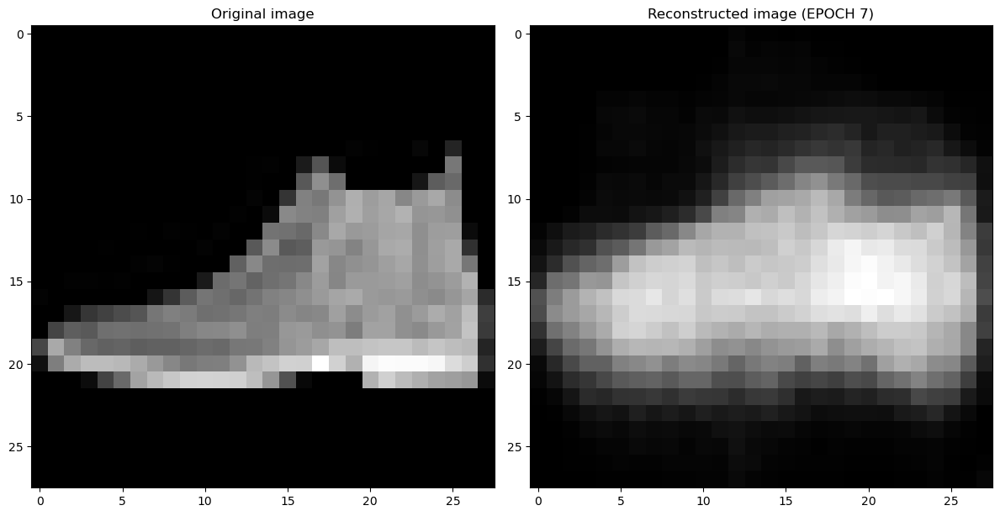

EPOCH 8/20
TRAIN - EPOCH 8/20 - loss: 0.03345621004700661
VALIDATION - EPOCH 8/20 - loss: 0.033010084182024



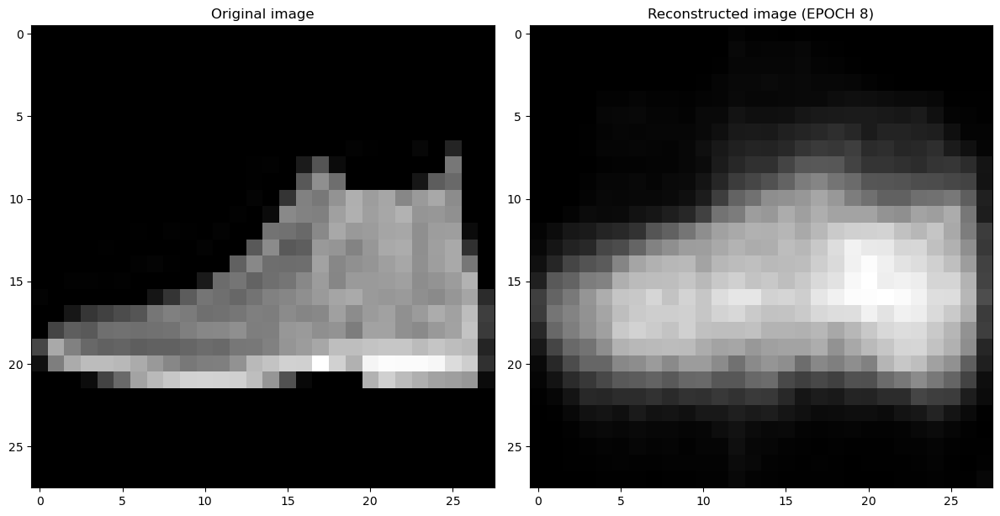

EPOCH 9/20
TRAIN - EPOCH 9/20 - loss: 0.0329805351793766
VALIDATION - EPOCH 9/20 - loss: 0.03263910487294197



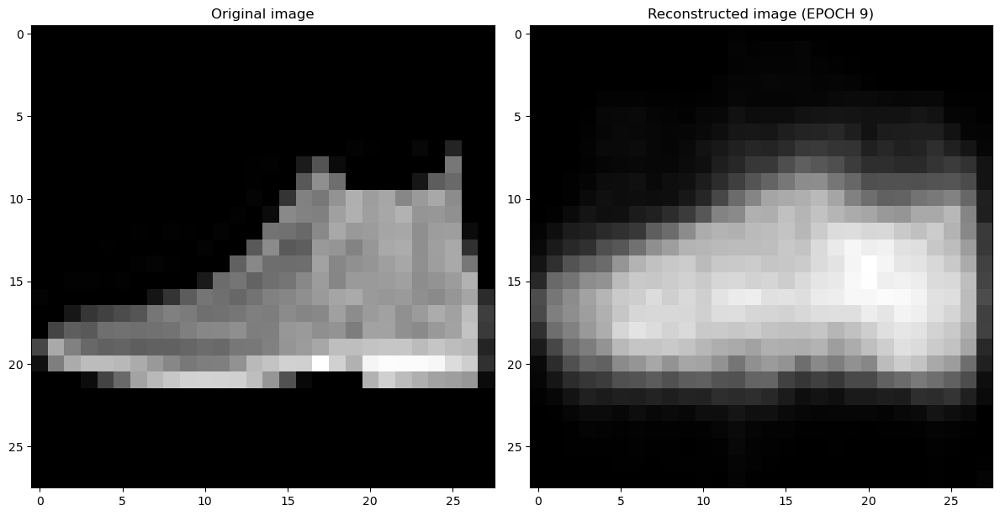

EPOCH 10/20
TRAIN - EPOCH 10/20 - loss: 0.03263277933001518
VALIDATION - EPOCH 10/20 - loss: 0.03230641037225723



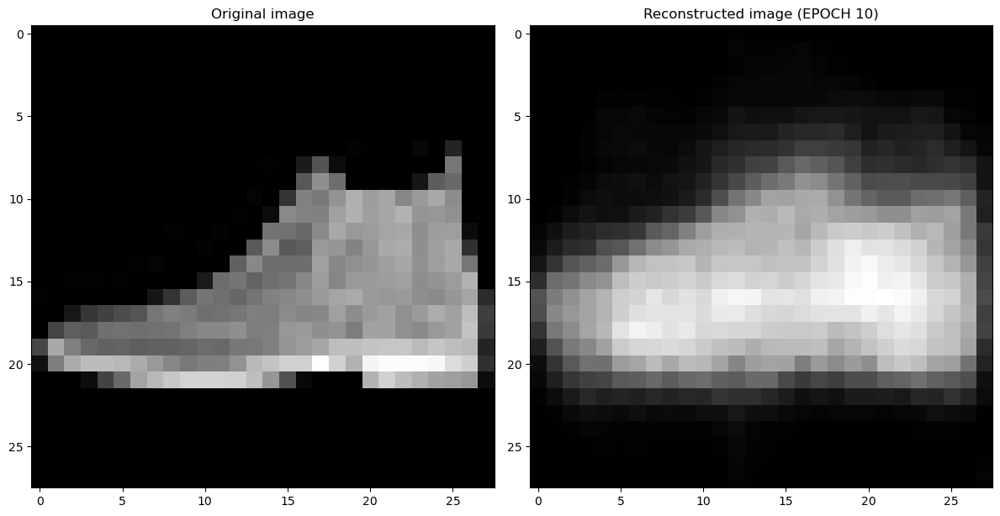

EPOCH 11/20
TRAIN - EPOCH 11/20 - loss: 0.03228514641523361
VALIDATION - EPOCH 11/20 - loss: 0.03209338337182999



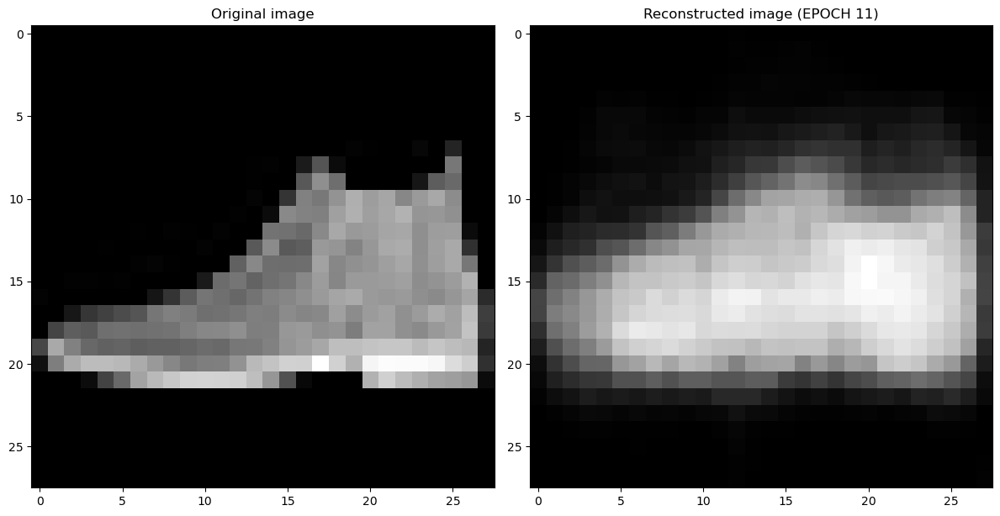

EPOCH 12/20
TRAIN - EPOCH 12/20 - loss: 0.03199940174818039
VALIDATION - EPOCH 12/20 - loss: 0.031933024525642395



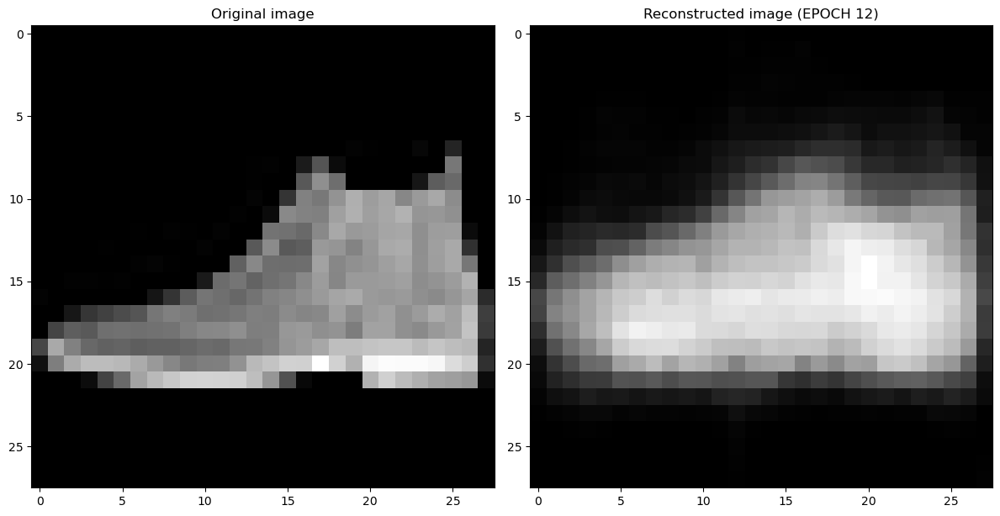

EPOCH 13/20
TRAIN - EPOCH 13/20 - loss: 0.031811390072107315
VALIDATION - EPOCH 13/20 - loss: 0.031931132078170776



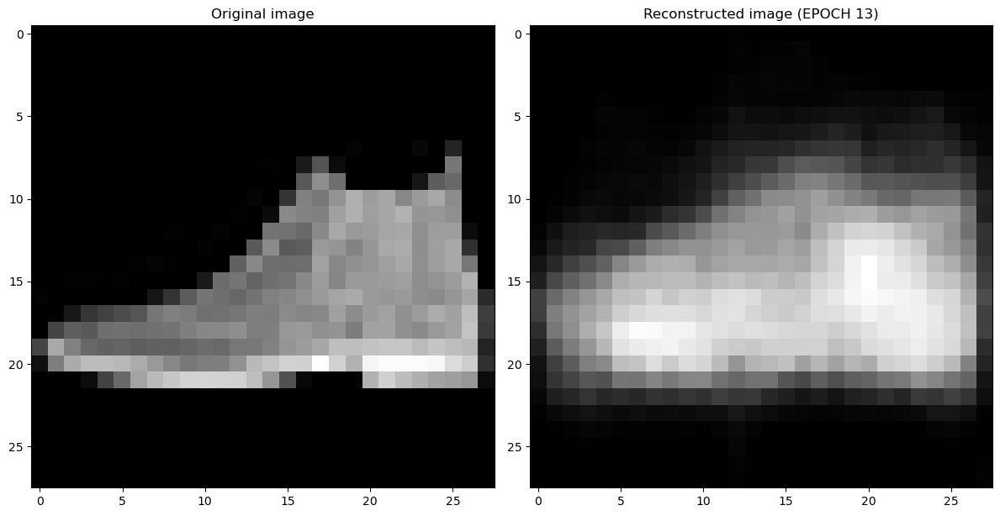

EPOCH 14/20
TRAIN - EPOCH 14/20 - loss: 0.03156079351902008
VALIDATION - EPOCH 14/20 - loss: 0.031655311584472656



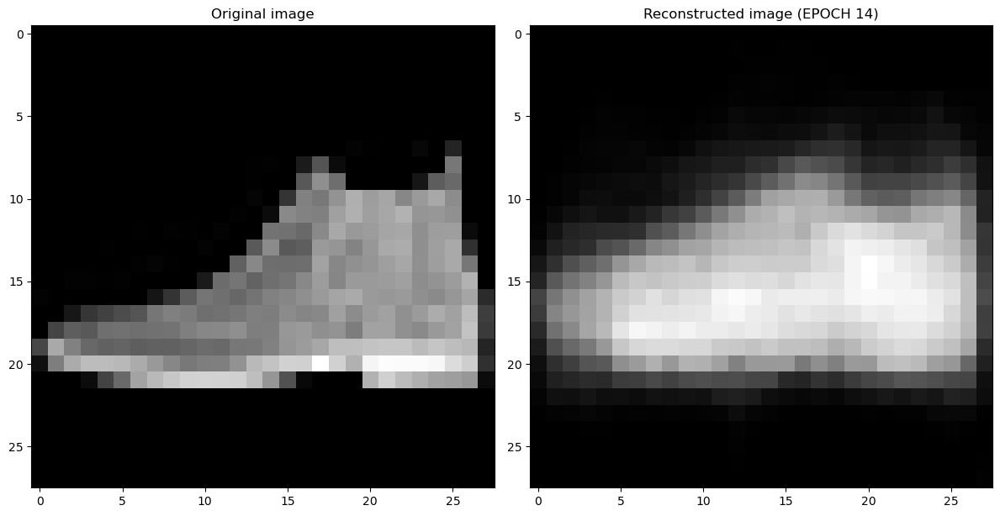

EPOCH 15/20
TRAIN - EPOCH 15/20 - loss: 0.03134854882955551
VALIDATION - EPOCH 15/20 - loss: 0.031202271580696106



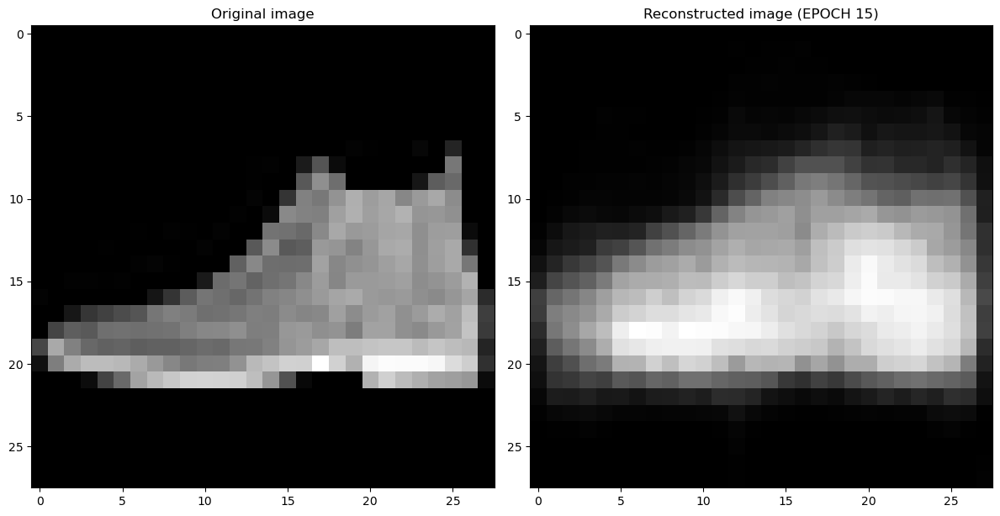

EPOCH 16/20
TRAIN - EPOCH 16/20 - loss: 0.031163571402430534
VALIDATION - EPOCH 16/20 - loss: 0.031055010855197906



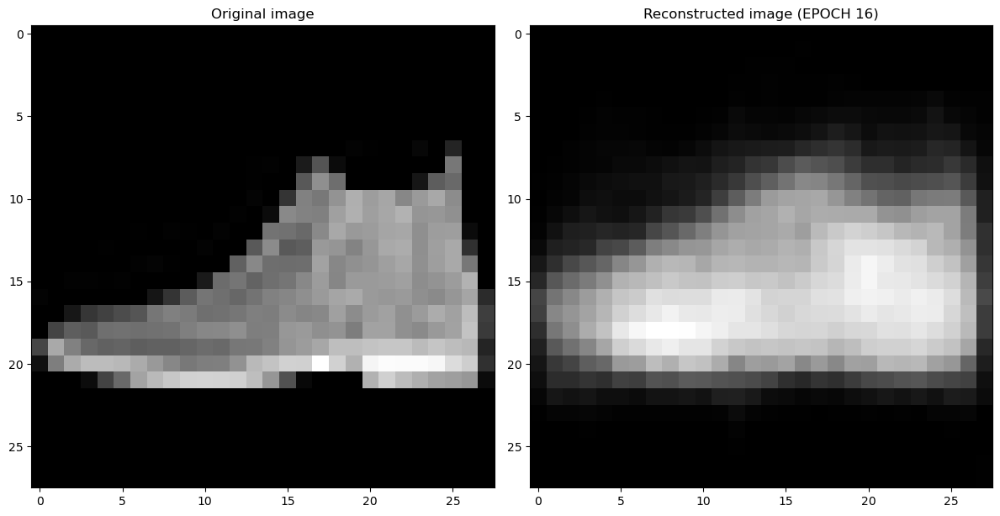

EPOCH 17/20
TRAIN - EPOCH 17/20 - loss: 0.03098272904753685
VALIDATION - EPOCH 17/20 - loss: 0.030991077423095703



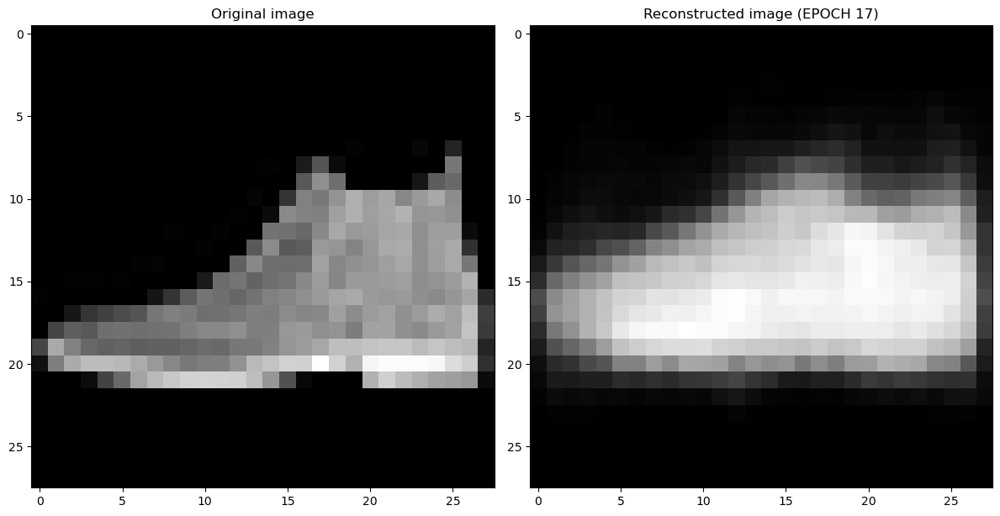

EPOCH 18/20
TRAIN - EPOCH 18/20 - loss: 0.030860871076583862
VALIDATION - EPOCH 18/20 - loss: 0.03104161098599434



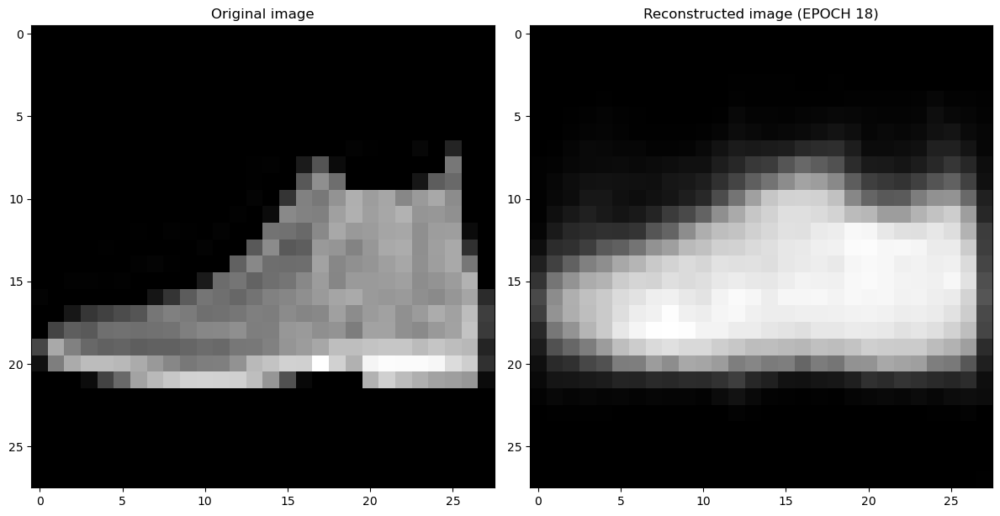

EPOCH 19/20
TRAIN - EPOCH 19/20 - loss: 0.030696313828229904
VALIDATION - EPOCH 19/20 - loss: 0.030652720481157303



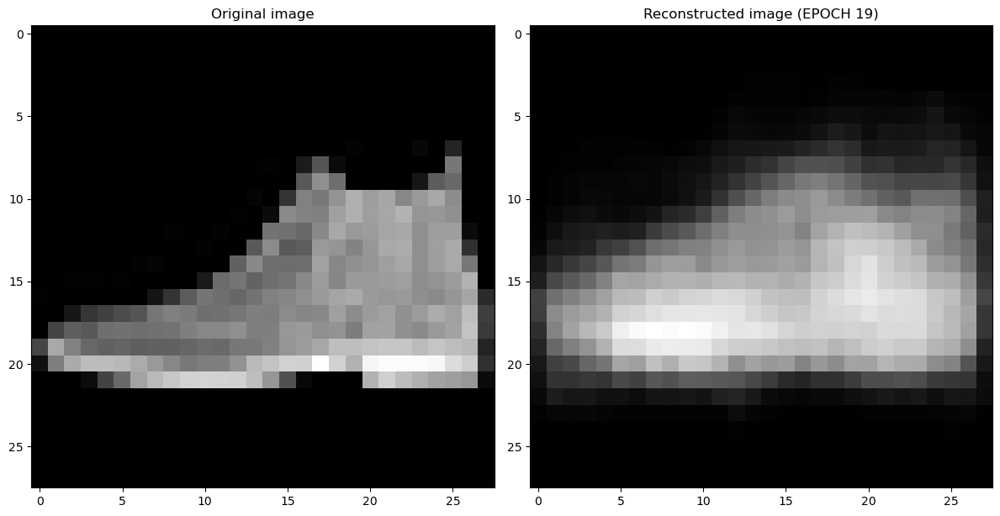

EPOCH 20/20
TRAIN - EPOCH 20/20 - loss: 0.030573366209864616
VALIDATION - EPOCH 20/20 - loss: 0.030531568452715874



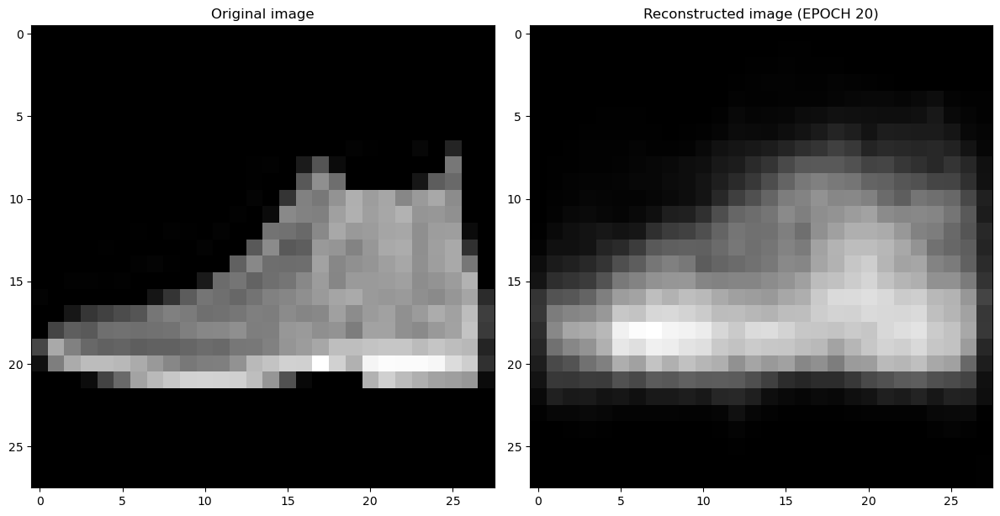

In [20]:
### Training cycle
num_epochs = 20
for epoch in range(num_epochs):
    print('EPOCH %d/%d' % (epoch + 1, num_epochs))
    ### Training (use the training function)
    train_loss = train_epoch(
        encoder=encoder,
        decoder=decoder,
        device=device,
        dataloader=train_dataloader,
        loss_fn=loss_fn,
        optimizer=optim)
    print(f'TRAIN - EPOCH {epoch+1}/{num_epochs} - loss: {train_loss}')

    ### Validation  (use the testing function)
    val_loss = test_epoch(
        encoder=encoder,
        decoder=decoder,
        device=device,
        dataloader=test_dataloader,
        loss_fn=loss_fn)
    # Print Validationloss
    print(f'VALIDATION - EPOCH {epoch+1}/{num_epochs} - loss: {val_loss}\n')


    ### Plot progress
    # Get the output of a specific image (the test image at index 0 in this case)
    img = test_dataset[0][0].unsqueeze(0).to(device)
    encoder.eval()
    decoder.eval()
    with torch.no_grad():
        rec_img  = decoder(encoder(img))
        
    # Plot the reconstructed image
    fig, axs = plt.subplots(1, 2, figsize=(12,6))
    axs[0].imshow(img.cpu().squeeze().numpy(), cmap='gist_gray')
    axs[0].set_title('Original image')
    axs[1].imshow(rec_img.cpu().squeeze().numpy(), cmap='gist_gray')
    axs[1].set_title('Reconstructed image (EPOCH %d)' % (epoch + 1))
    plt.tight_layout()
    plt.pause(0.1)
    
    # Save figures
    os.makedirs('autoencoder_progress_%d_features' % encoded_space_dim, exist_ok=True)
    fig.savefig('autoencoder_progress_%d_features/epoch_%d.jpg' % (encoded_space_dim, epoch + 1))
    plt.show()
    plt.close()

    # Save network parameters
    torch.save(encoder.state_dict(), 'encoder_params.pth')
    torch.save(decoder.state_dict(), 'decoder_params.pth')

    # NOTE: Remember to save also the parameters of the optimizer if you want to restore and continue the training

# Network Analysis

If you have a previously saved network, restore the network parameters.

In [21]:
# Load network parameters
encoder.load_state_dict(torch.load('encoder_params.pth'))
decoder.load_state_dict(torch.load('decoder_params.pth'))

<All keys matched successfully>

The encoder can be used to evaluate the latent space values for each of the test images. Since we used an encoded space dimension of 2, the encoder maps an entire image to just 2 floating point numbers.

We also save the corresponding label to show how each digit is mapped in the encoded space.

In [22]:
### Get the encoded representation of the test samples
encoded_samples = []
for sample in tqdm(test_dataset):
    img = sample[0].unsqueeze(0).to(device)
    label = sample[1]
    
    # Encode image
    encoder.eval()
    with torch.no_grad():
        encoded_img  = encoder(img)
        
    # Append to list
    encoded_img = encoded_img.flatten().cpu().numpy()
    encoded_sample = {f"Enc. Variable {i}": enc for i, enc in enumerate(encoded_img)}
    encoded_sample['label'] = label
    encoded_samples.append(encoded_sample)

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:02<00:00, 4455.48it/s]


For convenience (not required), convert the result to a table format (`pandas.DataFrame`):

In [23]:
# Convert to a dataframe
encoded_samples = pd.DataFrame(encoded_samples)
encoded_samples

,Enc. Variable 0,Enc. Variable 1,label
0,-4.768225,-11.733053,9
1,1.482077,8.956578,2
2,-32.514107,8.922192,1
3,-28.132776,5.260180,1
4,-2.419865,1.911062,6
...,...,...,...
9995,11.678854,-12.032460,9
9996,-21.175531,0.223278,1
9997,-6.036177,-0.993402,8
9998,-35.450039,5.806635,1


This graph shows where each input image is mapped in the encoded space. Since we have just 2 encoded variables, we can easily plot them in a bidimensional space.

In [24]:
import plotly.express as px
px.scatter(encoded_samples, x='Enc. Variable 0', y='Enc. Variable 1', color=[label_names[l] for l in encoded_samples.label.to_numpy()], opacity=0.7)

As you can see from the graph, even if we never used the labels (i.e. the id of the class in the image) during the training, the network has been able to clusterize quite well the different classes.

> **NOTE**
>
> The encoded space may have many more variables. In this case you can still have a visual representation of the encoded space by applying a dimensionality reduction method, such as:
- [Principal Component Analysis (PCA)](https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html)
- [t-distributed Stochastic Neighbor Embedding (t-SNE)](https://scikit-learn.org/stable/modules/generated/sklearn.manifold.TSNE.html)




While the encoder is able to map the image to the encoded space, the decoder can do the opposite, generating an image given the corresponding latent space values.

The latent space can also be manually customized, like in the following example, where we generate images with the decoder by providing custom latent space variables.

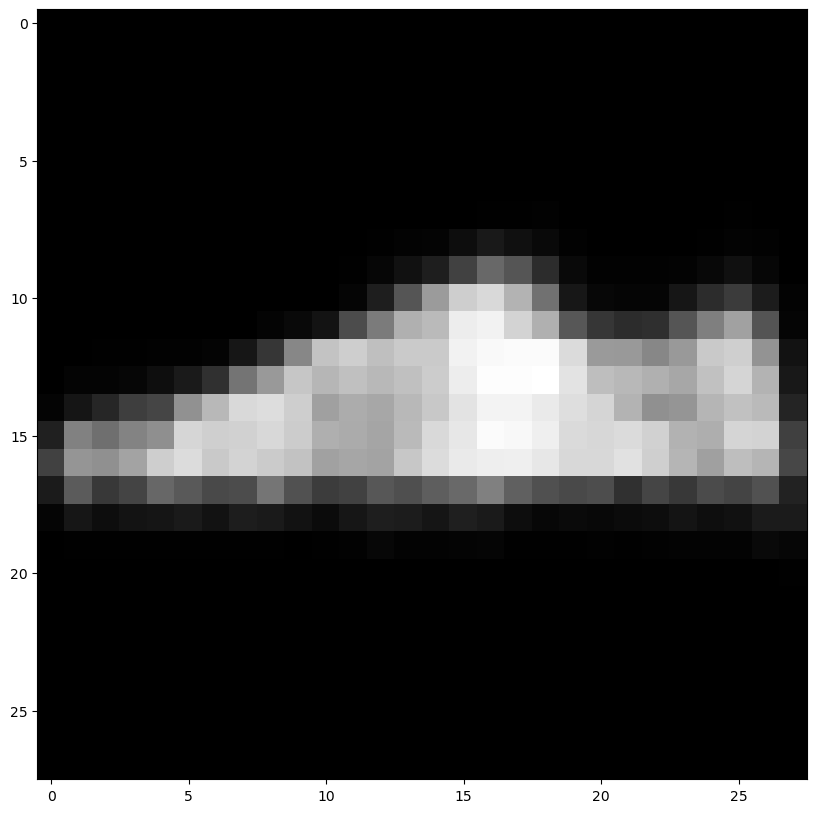

In [25]:
if encoded_space_dim == 2:
    # Generate a custom sample
    custom_encoded_sample = [-6, -30.0]
    encoded_value = torch.tensor(custom_encoded_sample).float().unsqueeze(0).to(device)

    # Decode sample
    decoder.eval()
    with torch.no_grad():
        generated_img  = decoder(encoded_value)

    plt.figure(figsize=(12,10))
    plt.imshow(generated_img.squeeze().cpu().numpy(), cmap='gist_gray')
    plt.show()

# Further insights on PCA and t-SNE

Let's do the same training again, with encoded dimension equal to 10.

Selected device: cuda
EPOCH 1/20
TRAIN - EPOCH 1/20 - loss: 0.10085093975067139

VALIDATION - EPOCH 1/20 - loss: 0.05414089187979698



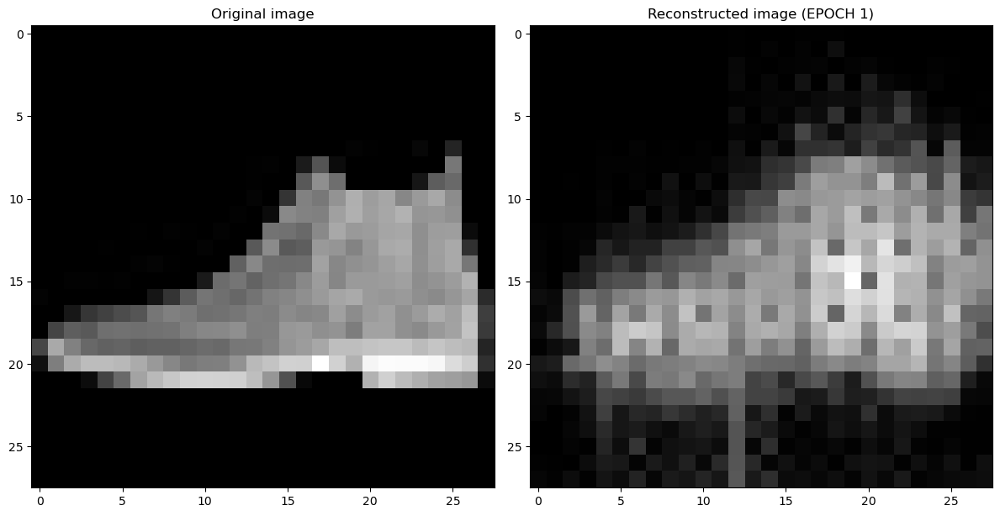

EPOCH 2/20
TRAIN - EPOCH 2/20 - loss: 0.03874124586582184

VALIDATION - EPOCH 2/20 - loss: 0.030625944957137108



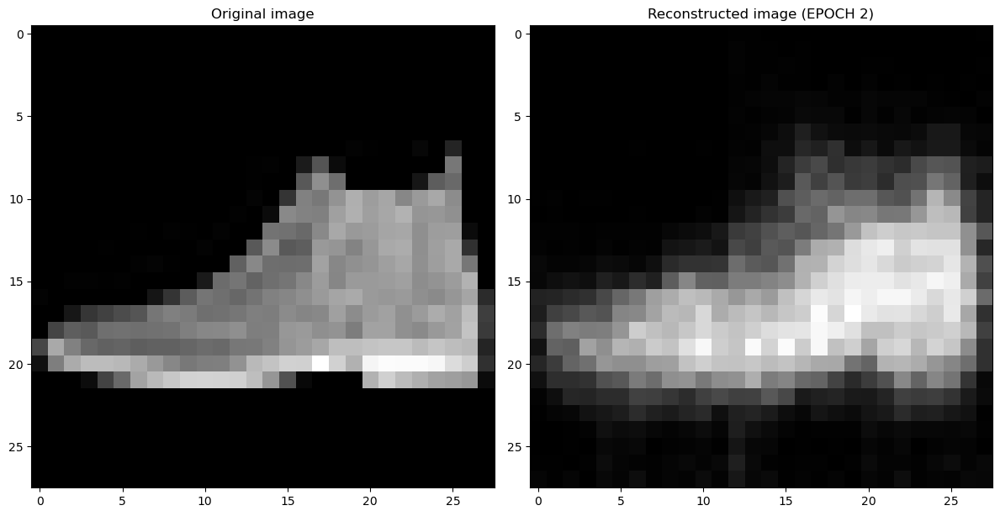

EPOCH 3/20
TRAIN - EPOCH 3/20 - loss: 0.028278782963752747

VALIDATION - EPOCH 3/20 - loss: 0.02665572427213192



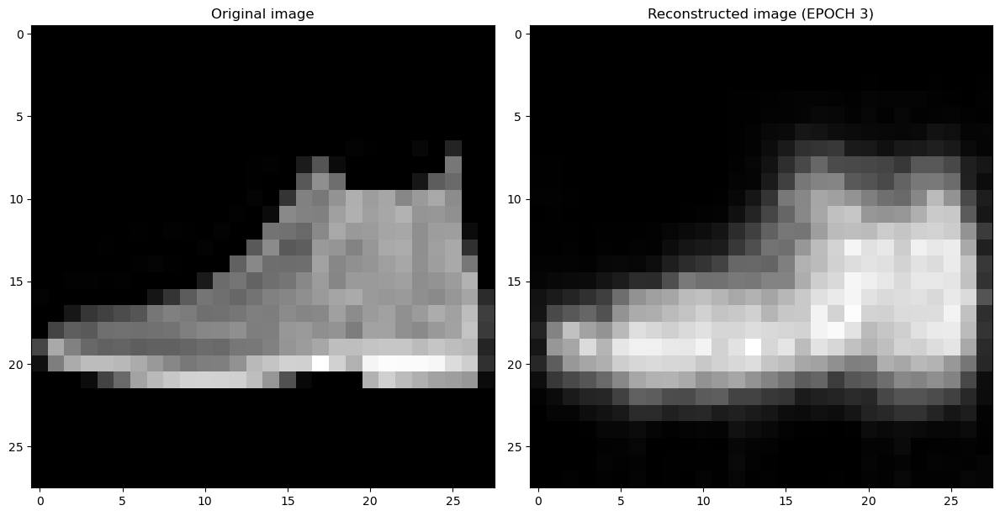

EPOCH 4/20
TRAIN - EPOCH 4/20 - loss: 0.02544054016470909

VALIDATION - EPOCH 4/20 - loss: 0.024743683636188507



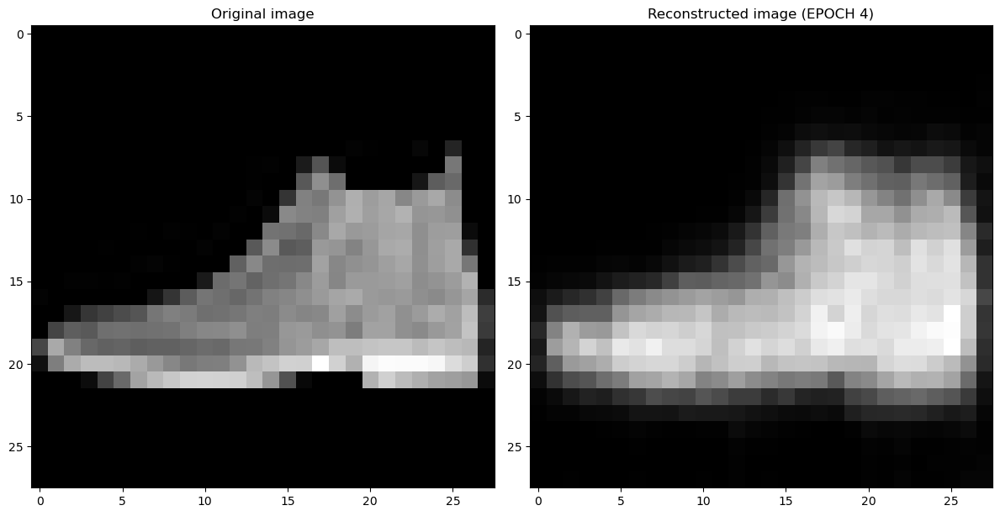

EPOCH 5/20
TRAIN - EPOCH 5/20 - loss: 0.0239386148750782

VALIDATION - EPOCH 5/20 - loss: 0.023487668484449387



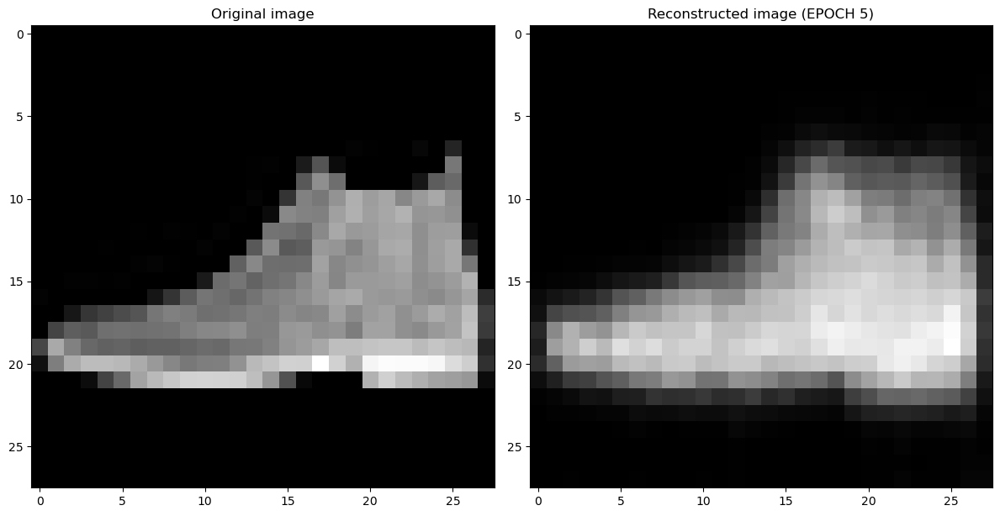

EPOCH 6/20
TRAIN - EPOCH 6/20 - loss: 0.022885965183377266

VALIDATION - EPOCH 6/20 - loss: 0.022580526769161224



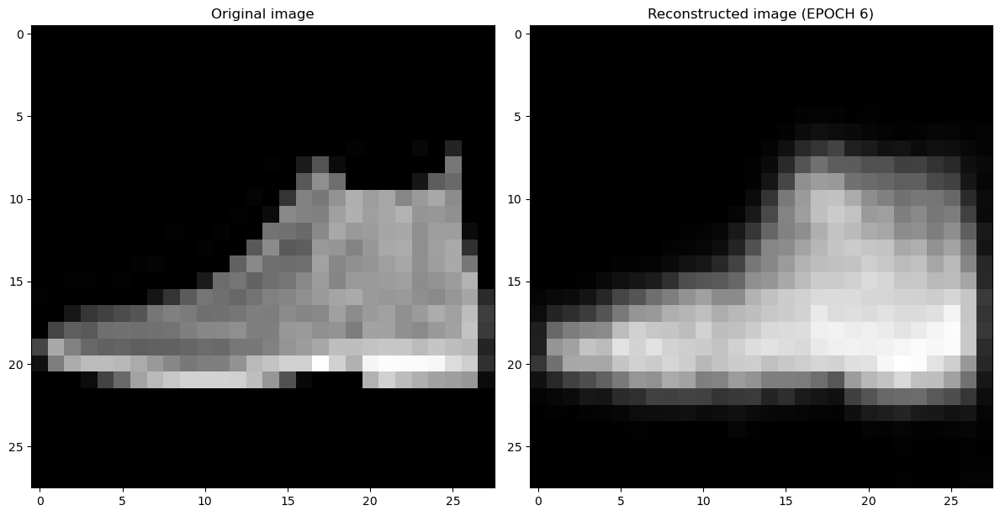

EPOCH 7/20
TRAIN - EPOCH 7/20 - loss: 0.02194014936685562

VALIDATION - EPOCH 7/20 - loss: 0.021667825058102608



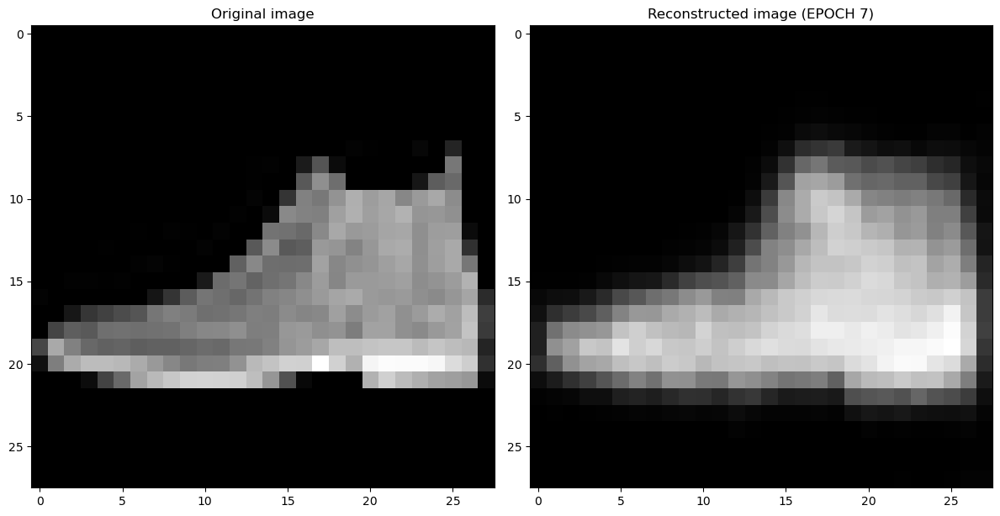

EPOCH 8/20
TRAIN - EPOCH 8/20 - loss: 0.021249443292617798

VALIDATION - EPOCH 8/20 - loss: 0.021086696535348892



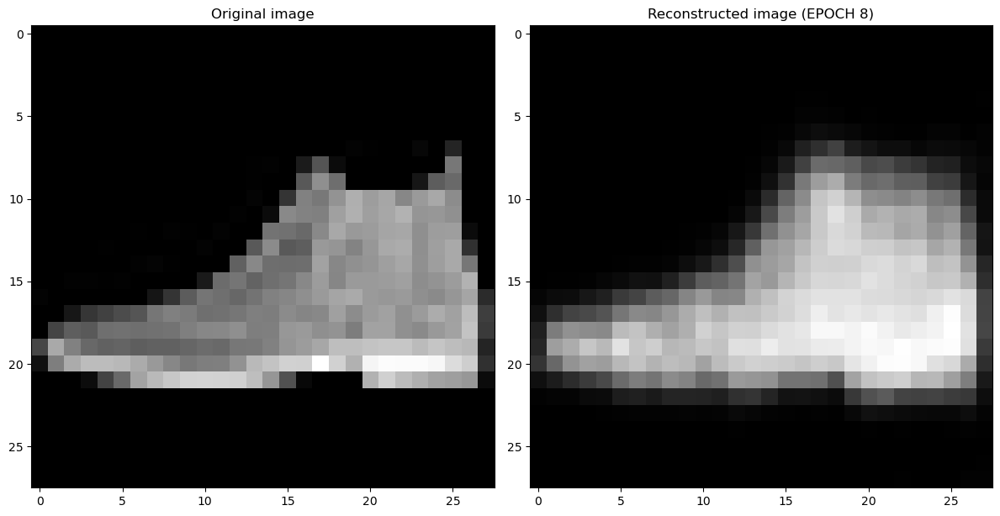

EPOCH 9/20
TRAIN - EPOCH 9/20 - loss: 0.020835310220718384

VALIDATION - EPOCH 9/20 - loss: 0.020720668137073517



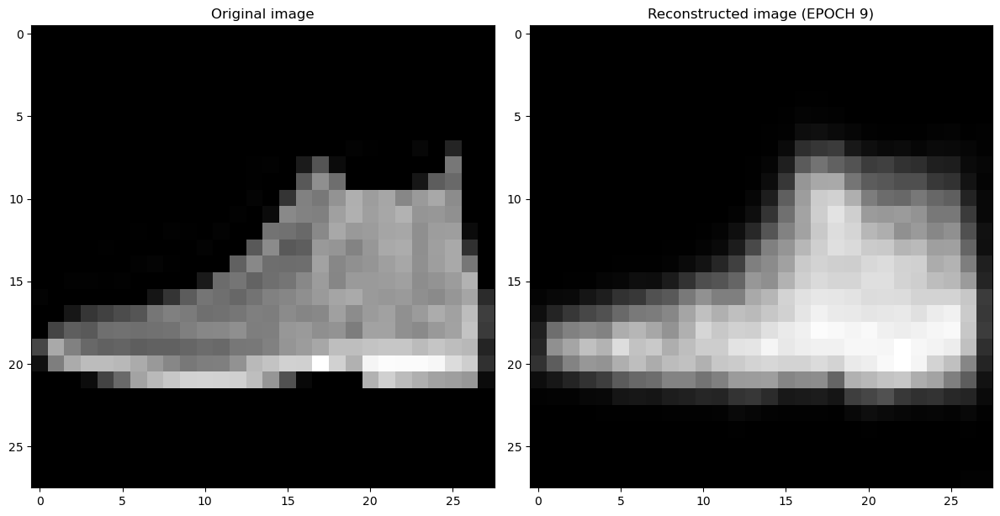

EPOCH 10/20
TRAIN - EPOCH 10/20 - loss: 0.020435836166143417

VALIDATION - EPOCH 10/20 - loss: 0.02036210335791111



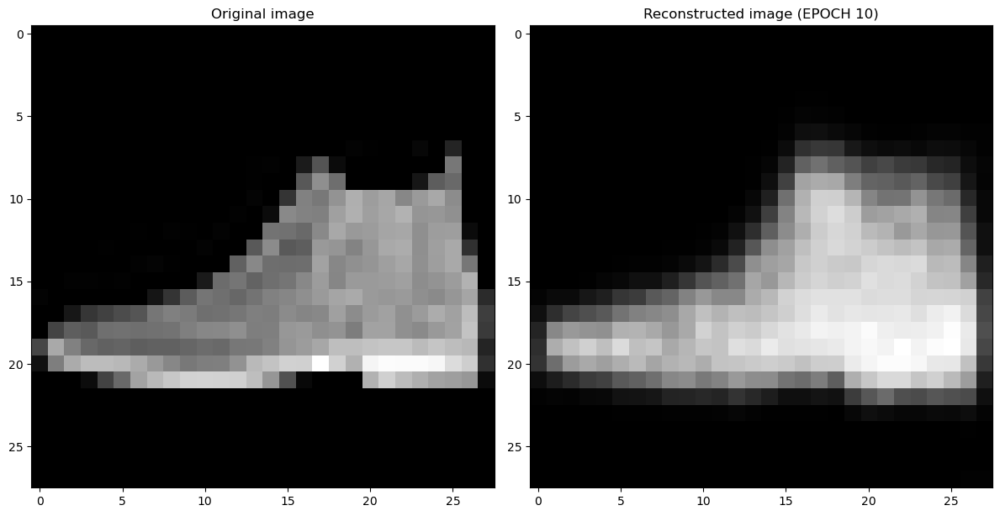

EPOCH 11/20
TRAIN - EPOCH 11/20 - loss: 0.02013007178902626

VALIDATION - EPOCH 11/20 - loss: 0.020124290138483047



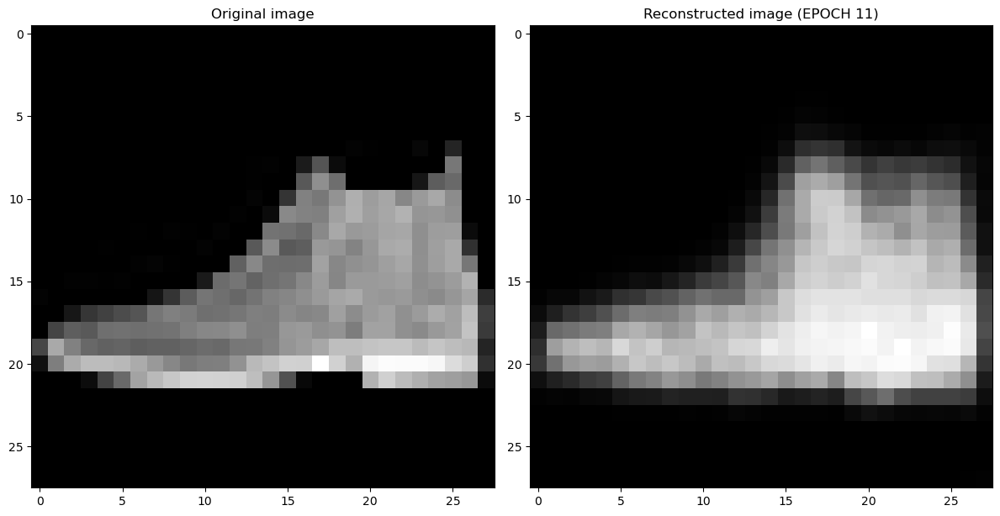

EPOCH 12/20
TRAIN - EPOCH 12/20 - loss: 0.019888129085302353

VALIDATION - EPOCH 12/20 - loss: 0.020064786076545715



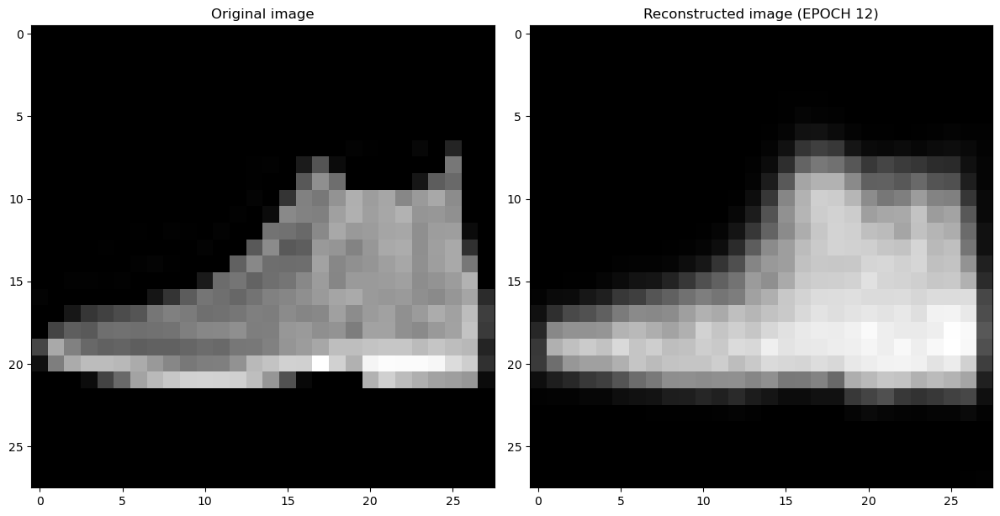

EPOCH 13/20
TRAIN - EPOCH 13/20 - loss: 0.01967022195458412

VALIDATION - EPOCH 13/20 - loss: 0.019657054916024208



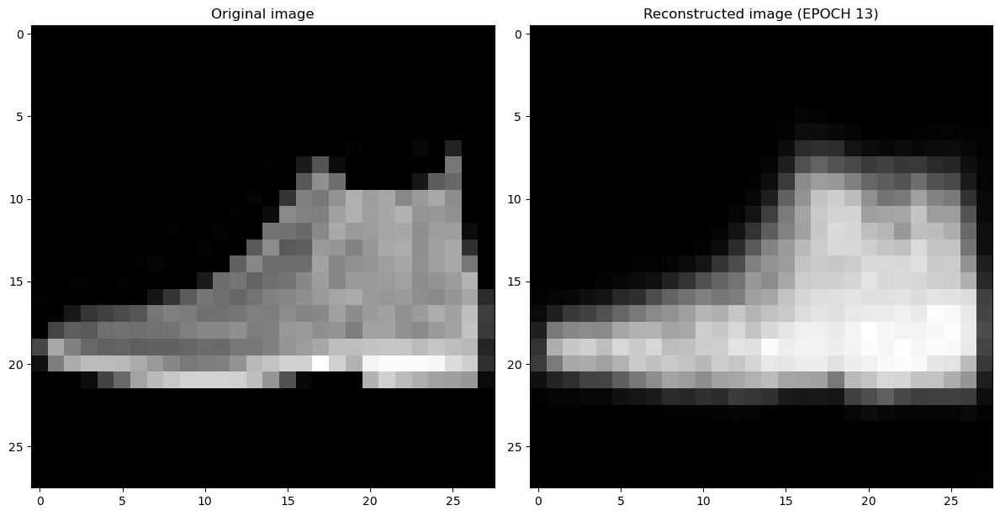

EPOCH 14/20
TRAIN - EPOCH 14/20 - loss: 0.019468368962407112

VALIDATION - EPOCH 14/20 - loss: 0.019545109942555428



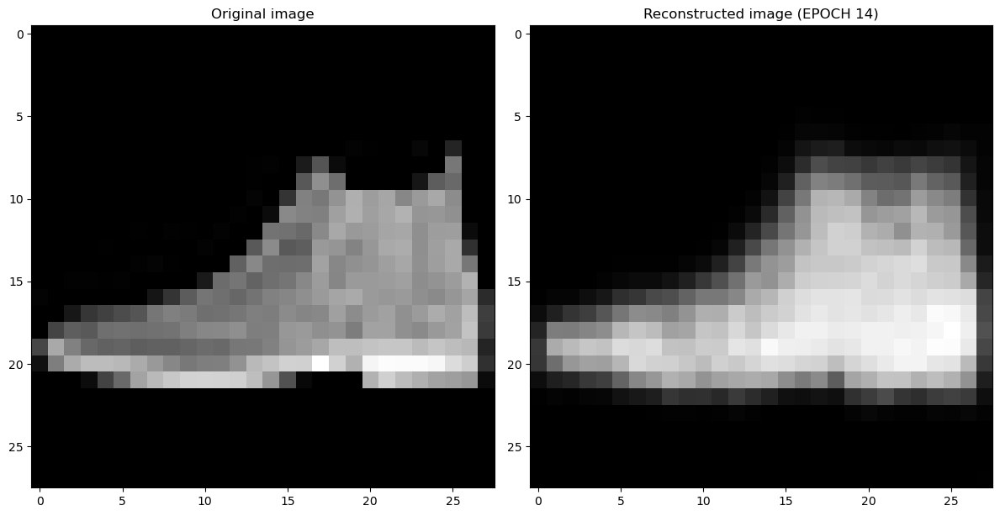

EPOCH 15/20
TRAIN - EPOCH 15/20 - loss: 0.01929180882871151

VALIDATION - EPOCH 15/20 - loss: 0.01933378539979458



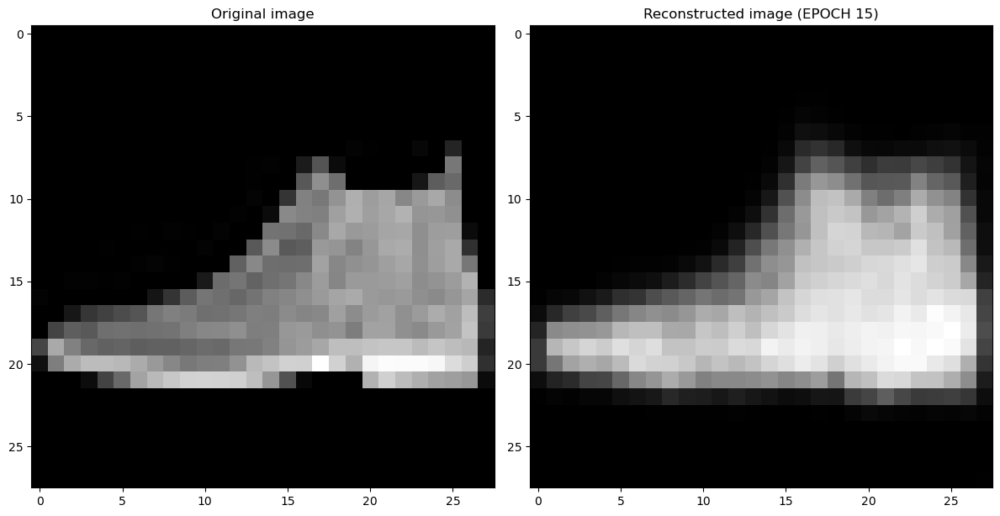

EPOCH 16/20
TRAIN - EPOCH 16/20 - loss: 0.019137172028422356

VALIDATION - EPOCH 16/20 - loss: 0.01924227736890316



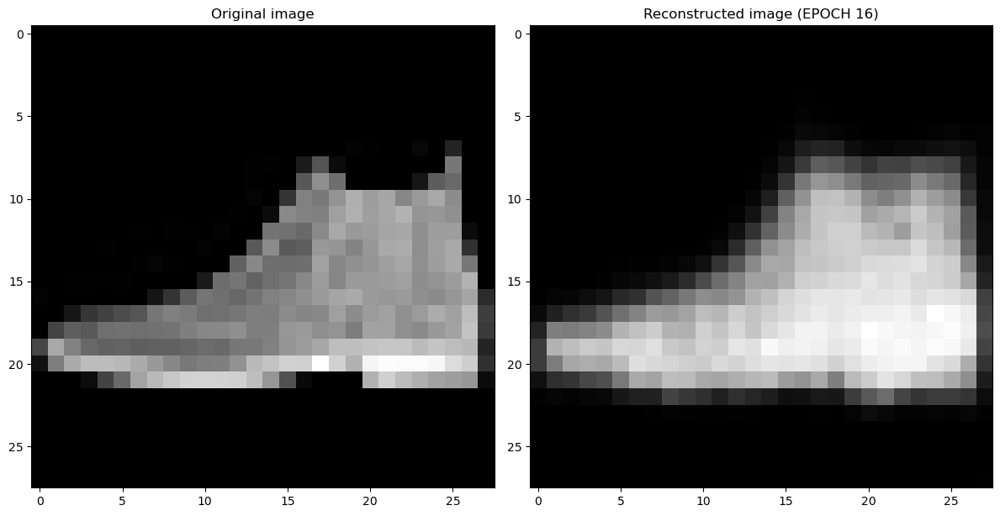

EPOCH 17/20
TRAIN - EPOCH 17/20 - loss: 0.018995849415659904

VALIDATION - EPOCH 17/20 - loss: 0.019030090421438217



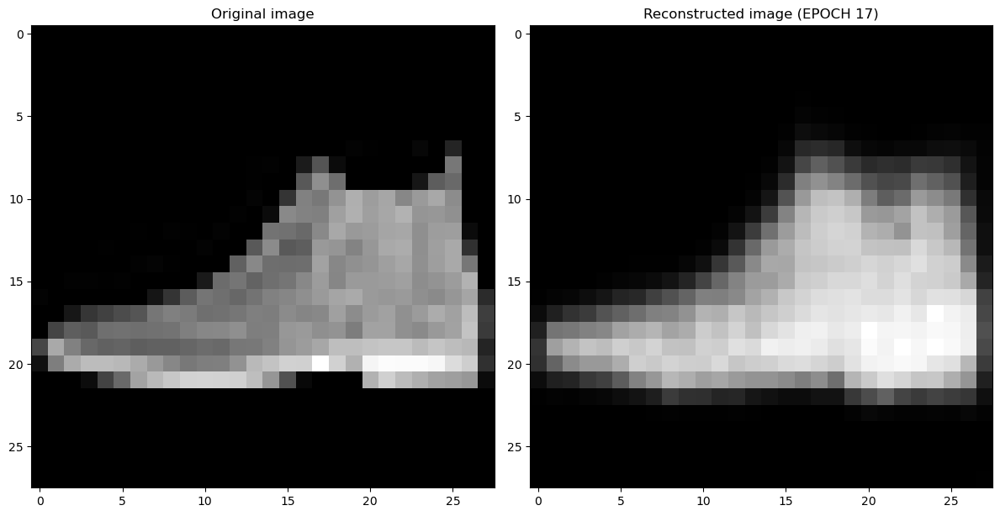

EPOCH 18/20
TRAIN - EPOCH 18/20 - loss: 0.018874160945415497

VALIDATION - EPOCH 18/20 - loss: 0.019018463790416718



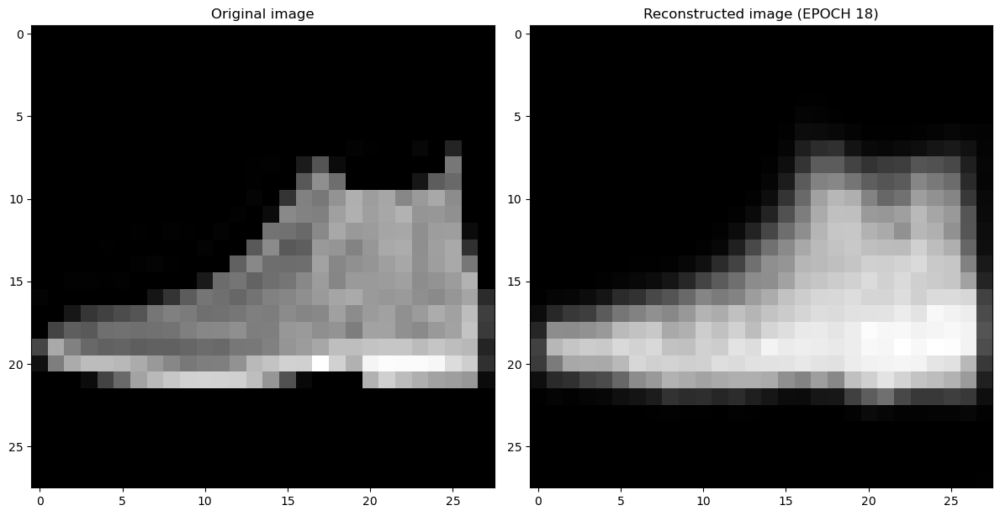

EPOCH 19/20
TRAIN - EPOCH 19/20 - loss: 0.018734924495220184

VALIDATION - EPOCH 19/20 - loss: 0.018771806731820107



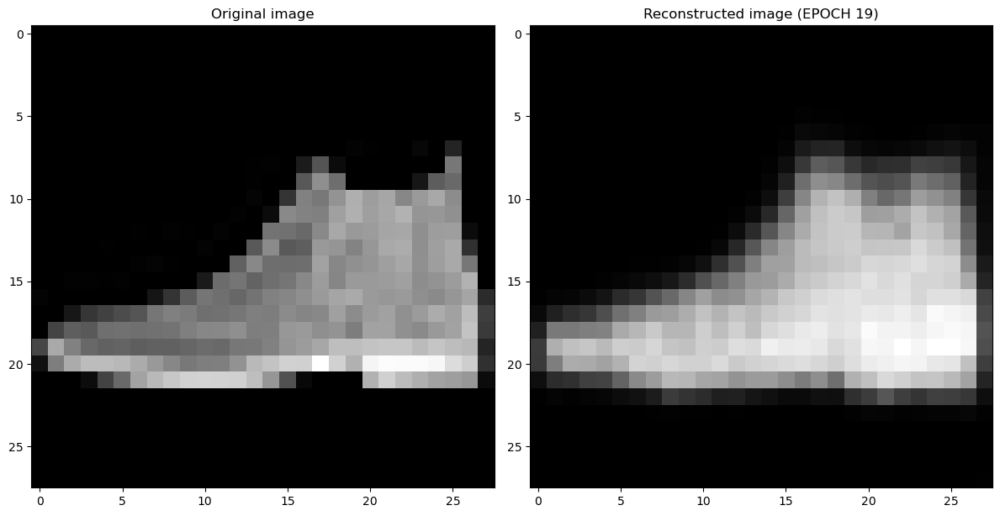

EPOCH 20/20
TRAIN - EPOCH 20/20 - loss: 0.018609095364809036

VALIDATION - EPOCH 20/20 - loss: 0.018667150288820267



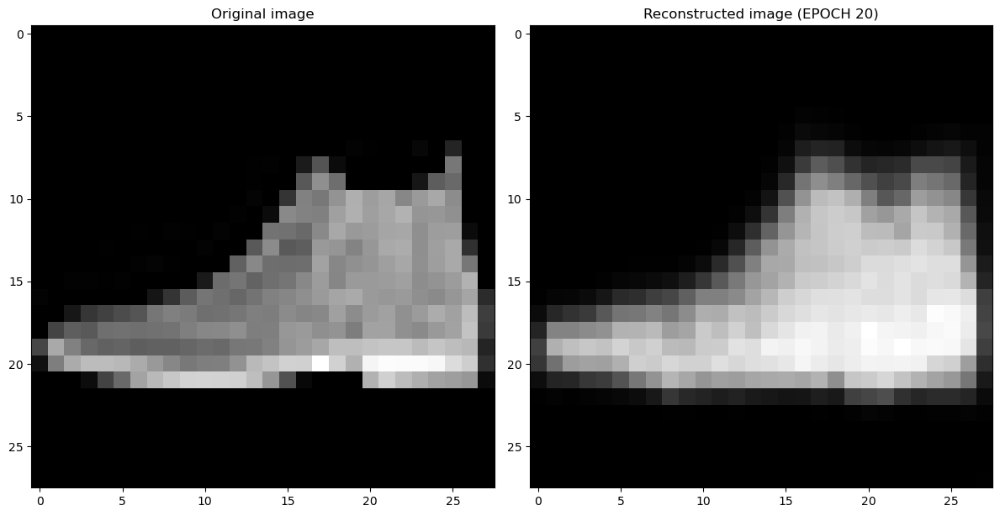

In [26]:
### Set the random seed for reproducible results
torch.manual_seed(0)

### Initialize the two networks
encoded_space_dim = 10  # this is the only line we change!
encoder = Encoder(encoded_space_dim=encoded_space_dim)
decoder = Decoder(encoded_space_dim=encoded_space_dim)


### Define the loss function
loss_fn = torch.nn.MSELoss()

### Define an optimizer (both for the encoder and the decoder!)
lr = 5e-4 # Learning rate
params_to_optimize = [
    {'params': encoder.parameters()},
    {'params': decoder.parameters()}
]
optim = torch.optim.Adam(params_to_optimize, lr=lr, weight_decay=1e-5)

# Check if the GPU is available
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(f'Selected device: {device}')

# Move both the encoder and the decoder to the selected device
encoder.to(device)
decoder.to(device)


### Training cycle
num_epochs = 20
for epoch in range(num_epochs):
    print('EPOCH %d/%d' % (epoch + 1, num_epochs))
    ### Training (use the training function)
    train_loss = train_epoch(
        encoder=encoder,
        decoder=decoder,
        device=device,
        dataloader=train_dataloader,
        loss_fn=loss_fn,
        optimizer=optim)
    print(f'TRAIN - EPOCH {epoch+1}/{num_epochs} - loss: {train_loss}\n')
    ### Validation  (use the testing function)
    val_loss = test_epoch(
        encoder=encoder,
        decoder=decoder,
        device=device,
        dataloader=test_dataloader,
        loss_fn=loss_fn)
    # Print Validationloss
    print(f'VALIDATION - EPOCH {epoch+1}/{num_epochs} - loss: {val_loss}\n')

    ### Plot progress
    # Get the output of a specific image (the test image at index 0 in this case)
    img = test_dataset[0][0].unsqueeze(0).to(device)
    encoder.eval()
    decoder.eval()
    with torch.no_grad():
        rec_img  = decoder(encoder(img))
    # Plot the reconstructed image
    fig, axs = plt.subplots(1, 2, figsize=(12,6))
    axs[0].imshow(img.cpu().squeeze().numpy(), cmap='gist_gray')
    axs[0].set_title('Original image')
    axs[1].imshow(rec_img.cpu().squeeze().numpy(), cmap='gist_gray')
    axs[1].set_title('Reconstructed image (EPOCH %d)' % (epoch + 1))
    plt.tight_layout()
    plt.pause(0.1)
    # Save figures
    os.makedirs('autoencoder_progress_%d_features' % encoded_space_dim, exist_ok=True)
    fig.savefig('autoencoder_progress_%d_features/epoch_%d.jpg' % (encoded_space_dim, epoch + 1))
    plt.show()
    plt.close()

In [27]:
### Get the encoded representation of the test samples
encoded_samples = []
for sample in tqdm(test_dataset):
    img = sample[0].unsqueeze(0).to(device)
    label = sample[1]
    # Encode image
    encoder.eval()
    with torch.no_grad():
        encoded_img  = encoder(img)
    # Append to list
    encoded_img = encoded_img.flatten().cpu().numpy()
    encoded_sample = {f"Enc. Variable {i}": enc for i, enc in enumerate(encoded_img)}
    encoded_sample['label'] = label
    encoded_samples.append(encoded_sample)

encoded_samples = pd.DataFrame(encoded_samples)
encoded_samples

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:02<00:00, 4431.86it/s]


,Enc. Variable 0,Enc. Variable 1,Enc. Variable 2,Enc. Variable 3,Enc. Variable 4,Enc. Variable 5,Enc. Variable 6,Enc. Variable 7,Enc. Variable 8,Enc. Variable 9,label
0,82.267197,-24.696039,-61.002666,29.787310,-59.548519,45.016319,-10.421770,20.400846,3.633411,-14.647538,9
1,55.753258,-47.093418,10.554729,3.614147,-3.788029,-7.749410,33.002628,-36.748123,-42.160328,9.996467,2
2,20.698666,-63.607700,-33.894630,-21.200430,26.234415,1.735451,23.158558,15.151403,-76.349991,9.743567,1
3,19.462671,-56.404572,-49.039536,-28.406111,21.021305,6.626560,13.310784,23.076973,-60.884552,21.036003,1
4,50.762859,-40.500275,-5.165769,-11.442607,-13.706800,4.930255,5.812628,-12.927279,-30.892241,23.715670,6
...,...,...,...,...,...,...,...,...,...,...,...
9995,88.991455,-21.714478,-30.115450,37.857399,-81.708733,22.369310,-19.805025,11.954216,1.737998,-16.249426,9
9996,26.334942,-51.936432,-55.011692,-28.965801,16.048077,16.684559,5.719711,25.294905,-49.975510,24.782305,1
9997,35.289787,-47.901733,-63.512203,-35.935257,-23.796700,2.227817,14.927732,0.273645,-11.846189,14.307272,8
9998,22.451250,-60.310287,-46.911407,-28.343822,25.170811,2.589067,11.887861,31.710033,-58.510891,9.601371,1


**How can we visualize data?** we like 2D-3D plots for intuition!

PCA and tSNE come into play.

In [28]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
encoded_samples_reduced_PCA = pca.fit_transform(encoded_samples)
encoded_samples_reduced_PCA

array([[-94.21960334,   8.51430403],
       [ 36.16638066, -48.34849726],
       [ 61.87614623,  39.16316536],
       ...,
       [  5.25453935,  25.94034165],
       [ 46.41131949,  56.69800838],
       [-63.846519  ,  24.35304159]], shape=(10000, 2))

In [29]:
encoded_samples_reduced_PCA = pd.DataFrame({
    "Enc. Variable 0": encoded_samples_reduced_PCA[:, 0],
    "Enc. Variable 1": encoded_samples_reduced_PCA[:, 1],
    "label":encoded_samples.label}
)
px.scatter(encoded_samples_reduced_PCA, x='Enc. Variable 0', y='Enc. Variable 1', color=[label_names[l] for l in encoded_samples.label.to_numpy()], opacity=0.7)

In [30]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, init="random", learning_rate="auto", perplexity=30)
encoded_samples_reduced_TSNE = tsne.fit_transform(encoded_samples)
encoded_samples_reduced_TSNE = pd.DataFrame({
    "Enc. Variable 0": encoded_samples_reduced_TSNE[:, 0],
    "Enc. Variable 1": encoded_samples_reduced_TSNE[:, 1],
    "label":encoded_samples.label}
)
px.scatter(encoded_samples_reduced_TSNE, x='Enc. Variable 0', y='Enc. Variable 1', color=[label_names[l] for l in encoded_samples.label.to_numpy()], opacity=0.7)

/tmp/ipykernel_4836/1379746421.py:8: DeprecationWarning:

__array__ implementation doesn't accept a copy keyword, so passing copy=False failed. __array__ must implement 'dtype' and 'copy' keyword arguments. To learn more, see the migration guide https://numpy.org/devdocs/numpy_2_0_migration_guide.html#adapting-to-changes-in-the-copy-keyword



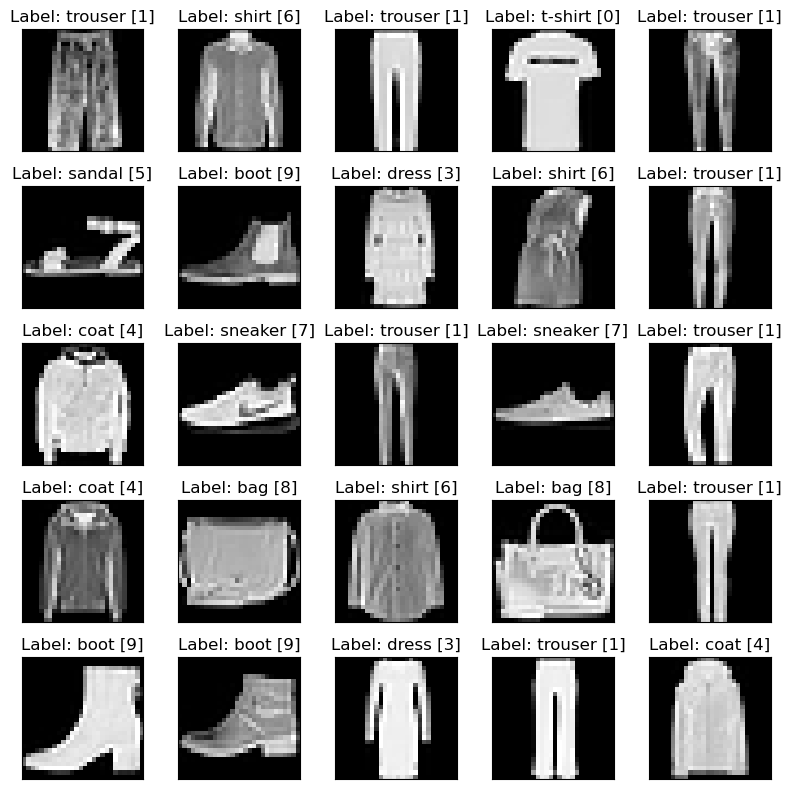

In [31]:
### Plot some sample
label_names=['t-shirt','trouser','pullover','dress','coat','sandal','shirt',
             'sneaker','bag','boot']
fig, axs = plt.subplots(5, 5, figsize=(8,8))
for ax in axs.flatten():
    # random.choice allows to randomly sample from a list-like object (basically anything that can be accessed with an index, like our dataset)
    img, label = random.choice(train_dataset)
    ax.imshow(np.array(img.permute(1,2,0).repeat(1, 1, 3)), cmap='gist_gray')
    ax.set_title(f'Label: {label_names[label]} [{label}]')
    ax.set_xticks([])
    ax.set_yticks([])
plt.tight_layout()

Given a point cloud:
*   **PCA** is like taking a snapshot from a different perspective/angle (linear only)
*   **tSNE** is like taking a snapshot from a different perspective/angle and at the same time stretching the space (non-linear)


# Classification from the latents
Since the latent representations produced by the encoder are usually clustered according to the different classes they can often be used as input to a classifier to solve the classification task.

Of course it is usually better to simply train the neural network for classification if you have enough labeled data. However since assigning labels to the input samples is often very expensive in some cases you might have partially labeled datasets.

 For this reason you could first train an autoencoder to extract some discriminative features in the data and then train a simpler classifier to take these as input and to predict the class.

This task can be usually solved by a simpler model that has lower likelyhood to overfit than a full end-to-end model given the low data avilability.

# Simple classifier on the features produced by the encoder
Here we define a dataset that returns the original images, their representations extracted with the encoder and the label.

In [32]:
from torch.utils.data import Dataset
from sklearn.model_selection import train_test_split

class AEDataset(Dataset):

    def __init__(self, encoder, normal_dataloader, device):
        encoder = encoder.to(device)
        self.x = []
        self.y = []
        self.latents = []
        for x, y in normal_dataloader:
            self.x.append(x)
            self.y.append(y)
            x = x.to(device)
            latents = encoder(x).detach().cpu()
            self.latents.append(latents)

        self.x = torch.cat(self.x, axis=0)
        self.y = torch.cat(self.y, axis=0)
        self.latents = torch.cat(self.latents, axis=0)
        self.x, _, self.latents, _, self.y, _ = train_test_split(self.x, self.latents, self.y, train_size=0.01, stratify=self.y)

    def __len__(self):
        return len(self.x)

    def __getitem__(self, idx):
        return self.x[idx], self.latents[idx],  self.y[idx]

In [33]:
class SimpleClassifier(nn.Module):

    def __init__(self, encoded_space_dim):
        super().__init__()

        self.classifier = nn.Sequential(
            nn.Linear(encoded_space_dim, 128),
            nn.ReLU(True),
            nn.Linear(128, 10)
        )

    def forward(self, x):
        x = self.classifier(x)
        return x

In [34]:
from sklearn.metrics import accuracy_score

### Set the random seed for reproducible results
torch.manual_seed(0)

model = SimpleClassifier(encoded_space_dim)
train_dataloader_latents = DataLoader(AEDataset(encoder, train_dataloader, device), batch_size=32, shuffle=True)

### Define the loss function
loss_fn = torch.nn.CrossEntropyLoss()

### Define an optimizer
lr = 5e-4 # Learning rate
optim = torch.optim.Adam(model.parameters(), lr=lr)

# Check if the GPU is available
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(f'Selected device: {device}')

# Move both the encoder and the decoder to the selected device
model.to(device)

### Training cycle
num_epochs = 100
val_losses_enc = []
val_accs_enc = []

for epoch in range(num_epochs):
    print('EPOCH %d/%d' % (epoch + 1, num_epochs))
    
    model.train()
    
    for x, latents, y in tqdm(train_dataloader_latents):

        # Move to device.
        latents = latents.to(device)
        y = y.to(device)

        # Get the prediction.
        y_pred = model(latents)

        # Compute the loss.
        loss = loss_fn(y_pred, y)

        # Zero the gradients.
        optim.zero_grad()

        # Backward pass.
        loss.backward()

        # Update the weights.
        optim.step()

    # Set evaluation mode
    model.eval()
    encoder.eval()
    
    with torch.no_grad(): # No need to track the gradients
        
        # Define the lists to store the outputs for each batch
        conc_out = []
        conc_label = []
        
        for image_batch, y in test_dataloader:
            
            # Move tensor to the proper device
            image_batch = image_batch.to(device)
            encoded_data = encoder(image_batch)

            # Get the prediction.
            y_pred = model(encoded_data)
            
            # Append the network output and the original image to the lists
            conc_out.append(y_pred.cpu())
            conc_label.append(y)
            
        # Create a single tensor with all the values in the lists
        conc_out = torch.cat(conc_out)
        conc_label = torch.cat(conc_label)
        
        # Evaluate global loss and accuracy
        val_loss = loss_fn(conc_out, conc_label)
        val_acc = accuracy_score(conc_label, conc_out.softmax(axis=1).argmax(axis=1))
        val_losses_enc.append(val_loss)
        val_accs_enc.append(val_acc)


    print(f'\t VALIDATION - EPOCH {epoch + 1}/{num_epochs} - loss: {val_loss} - acc {val_acc}')

Selected device: cuda
EPOCH 1/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1159.78it/s]


	 VALIDATION - EPOCH 1/100 - loss: 3.2688121795654297 - acc 0.391
EPOCH 2/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1543.91it/s]


	 VALIDATION - EPOCH 2/100 - loss: 1.6659501791000366 - acc 0.4066
EPOCH 3/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1736.13it/s]


	 VALIDATION - EPOCH 3/100 - loss: 1.1605939865112305 - acc 0.6069
EPOCH 4/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1589.23it/s]


	 VALIDATION - EPOCH 4/100 - loss: 1.0376300811767578 - acc 0.6368
EPOCH 5/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1520.66it/s]


	 VALIDATION - EPOCH 5/100 - loss: 1.0137462615966797 - acc 0.6384
EPOCH 6/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1504.38it/s]


	 VALIDATION - EPOCH 6/100 - loss: 0.9322956204414368 - acc 0.6725
EPOCH 7/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1620.21it/s]


	 VALIDATION - EPOCH 7/100 - loss: 0.9153923988342285 - acc 0.6721
EPOCH 8/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1626.73it/s]


	 VALIDATION - EPOCH 8/100 - loss: 0.8983415961265564 - acc 0.6693
EPOCH 9/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1645.37it/s]


	 VALIDATION - EPOCH 9/100 - loss: 0.8996245265007019 - acc 0.6661
EPOCH 10/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1691.32it/s]


	 VALIDATION - EPOCH 10/100 - loss: 0.8580541014671326 - acc 0.6881
EPOCH 11/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1651.03it/s]


	 VALIDATION - EPOCH 11/100 - loss: 0.8494539260864258 - acc 0.6794
EPOCH 12/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1607.43it/s]


	 VALIDATION - EPOCH 12/100 - loss: 0.8599005937576294 - acc 0.674
EPOCH 13/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1725.83it/s]


	 VALIDATION - EPOCH 13/100 - loss: 0.817096471786499 - acc 0.6939
EPOCH 14/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1514.10it/s]


	 VALIDATION - EPOCH 14/100 - loss: 0.8591717481613159 - acc 0.6832
EPOCH 15/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1684.03it/s]


	 VALIDATION - EPOCH 15/100 - loss: 0.8296704292297363 - acc 0.681
EPOCH 16/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1752.89it/s]


	 VALIDATION - EPOCH 16/100 - loss: 0.8550173044204712 - acc 0.6799
EPOCH 17/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1546.84it/s]


	 VALIDATION - EPOCH 17/100 - loss: 0.7911753058433533 - acc 0.7001
EPOCH 18/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1553.29it/s]


	 VALIDATION - EPOCH 18/100 - loss: 0.8139037489891052 - acc 0.6992
EPOCH 19/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1615.32it/s]


	 VALIDATION - EPOCH 19/100 - loss: 0.8011265397071838 - acc 0.6907
EPOCH 20/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1692.76it/s]


	 VALIDATION - EPOCH 20/100 - loss: 0.8161978721618652 - acc 0.6818
EPOCH 21/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1635.11it/s]


	 VALIDATION - EPOCH 21/100 - loss: 0.8075217604637146 - acc 0.6929
EPOCH 22/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1617.65it/s]


	 VALIDATION - EPOCH 22/100 - loss: 0.8297379016876221 - acc 0.6892
EPOCH 23/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1593.48it/s]


	 VALIDATION - EPOCH 23/100 - loss: 0.8239668011665344 - acc 0.69
EPOCH 24/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1663.33it/s]


	 VALIDATION - EPOCH 24/100 - loss: 0.7994084358215332 - acc 0.6938
EPOCH 25/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1659.14it/s]


	 VALIDATION - EPOCH 25/100 - loss: 0.7750791907310486 - acc 0.71
EPOCH 26/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1656.00it/s]


	 VALIDATION - EPOCH 26/100 - loss: 0.7715914845466614 - acc 0.7108
EPOCH 27/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1662.36it/s]


	 VALIDATION - EPOCH 27/100 - loss: 0.7835858464241028 - acc 0.7081
EPOCH 28/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1656.14it/s]


	 VALIDATION - EPOCH 28/100 - loss: 0.8052850365638733 - acc 0.7019
EPOCH 29/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1332.33it/s]


	 VALIDATION - EPOCH 29/100 - loss: 0.7762218117713928 - acc 0.7055
EPOCH 30/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1651.81it/s]


	 VALIDATION - EPOCH 30/100 - loss: 0.789592981338501 - acc 0.6969
EPOCH 31/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1685.67it/s]


	 VALIDATION - EPOCH 31/100 - loss: 0.7762474417686462 - acc 0.706
EPOCH 32/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1656.38it/s]


	 VALIDATION - EPOCH 32/100 - loss: 0.7624514698982239 - acc 0.7109
EPOCH 33/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1511.35it/s]


	 VALIDATION - EPOCH 33/100 - loss: 0.7873885035514832 - acc 0.7049
EPOCH 34/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1581.63it/s]


	 VALIDATION - EPOCH 34/100 - loss: 0.8074612021446228 - acc 0.7002
EPOCH 35/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1709.28it/s]


	 VALIDATION - EPOCH 35/100 - loss: 0.7788739800453186 - acc 0.7023
EPOCH 36/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1694.74it/s]


	 VALIDATION - EPOCH 36/100 - loss: 0.7755727171897888 - acc 0.705
EPOCH 37/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1690.07it/s]


	 VALIDATION - EPOCH 37/100 - loss: 0.7895614504814148 - acc 0.707
EPOCH 38/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1421.57it/s]


	 VALIDATION - EPOCH 38/100 - loss: 0.7958953976631165 - acc 0.6992
EPOCH 39/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1699.69it/s]


	 VALIDATION - EPOCH 39/100 - loss: 0.7831664681434631 - acc 0.6994
EPOCH 40/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1645.71it/s]


	 VALIDATION - EPOCH 40/100 - loss: 0.7977732419967651 - acc 0.6925
EPOCH 41/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1678.25it/s]


	 VALIDATION - EPOCH 41/100 - loss: 0.7756697535514832 - acc 0.7085
EPOCH 42/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1610.59it/s]


	 VALIDATION - EPOCH 42/100 - loss: 0.7974157929420471 - acc 0.6947
EPOCH 43/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1503.11it/s]


	 VALIDATION - EPOCH 43/100 - loss: 0.7700009942054749 - acc 0.7103
EPOCH 44/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1577.21it/s]


	 VALIDATION - EPOCH 44/100 - loss: 0.7665785551071167 - acc 0.7135
EPOCH 45/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1624.14it/s]


	 VALIDATION - EPOCH 45/100 - loss: 0.7904418706893921 - acc 0.7088
EPOCH 46/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1453.91it/s]


	 VALIDATION - EPOCH 46/100 - loss: 0.7648761868476868 - acc 0.7105
EPOCH 47/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1637.89it/s]


	 VALIDATION - EPOCH 47/100 - loss: 0.8379100561141968 - acc 0.681
EPOCH 48/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1573.38it/s]


	 VALIDATION - EPOCH 48/100 - loss: 0.7618736624717712 - acc 0.7127
EPOCH 49/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1656.59it/s]


	 VALIDATION - EPOCH 49/100 - loss: 0.7802642583847046 - acc 0.7143
EPOCH 50/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1634.84it/s]


	 VALIDATION - EPOCH 50/100 - loss: 0.7924996614456177 - acc 0.712
EPOCH 51/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1610.81it/s]


	 VALIDATION - EPOCH 51/100 - loss: 0.8190106153488159 - acc 0.6907
EPOCH 52/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1643.50it/s]


	 VALIDATION - EPOCH 52/100 - loss: 0.7968495488166809 - acc 0.7068
EPOCH 53/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1662.64it/s]


	 VALIDATION - EPOCH 53/100 - loss: 0.7836137413978577 - acc 0.6998
EPOCH 54/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1601.68it/s]


	 VALIDATION - EPOCH 54/100 - loss: 0.7877419590950012 - acc 0.7042
EPOCH 55/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1604.17it/s]


	 VALIDATION - EPOCH 55/100 - loss: 0.7989646196365356 - acc 0.7149
EPOCH 56/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1659.07it/s]


	 VALIDATION - EPOCH 56/100 - loss: 0.7819072008132935 - acc 0.7139
EPOCH 57/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1614.40it/s]


	 VALIDATION - EPOCH 57/100 - loss: 0.8256523609161377 - acc 0.7014
EPOCH 58/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1508.06it/s]


	 VALIDATION - EPOCH 58/100 - loss: 0.8805347681045532 - acc 0.6856
EPOCH 59/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1661.66it/s]


	 VALIDATION - EPOCH 59/100 - loss: 0.796942949295044 - acc 0.7043
EPOCH 60/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1643.71it/s]


	 VALIDATION - EPOCH 60/100 - loss: 0.8022602796554565 - acc 0.701
EPOCH 61/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1632.39it/s]


	 VALIDATION - EPOCH 61/100 - loss: 0.7758193612098694 - acc 0.7158
EPOCH 62/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1571.86it/s]


	 VALIDATION - EPOCH 62/100 - loss: 0.7739704847335815 - acc 0.7109
EPOCH 63/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1645.37it/s]


	 VALIDATION - EPOCH 63/100 - loss: 0.7946595549583435 - acc 0.7048
EPOCH 64/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1628.92it/s]


	 VALIDATION - EPOCH 64/100 - loss: 0.7897175550460815 - acc 0.7118
EPOCH 65/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1681.05it/s]


	 VALIDATION - EPOCH 65/100 - loss: 0.8279969692230225 - acc 0.6855
EPOCH 66/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1562.00it/s]


	 VALIDATION - EPOCH 66/100 - loss: 0.7771718502044678 - acc 0.7126
EPOCH 67/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1673.25it/s]


	 VALIDATION - EPOCH 67/100 - loss: 0.7906152009963989 - acc 0.7183
EPOCH 68/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1753.74it/s]


	 VALIDATION - EPOCH 68/100 - loss: 0.8119809031486511 - acc 0.7019
EPOCH 69/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1771.40it/s]


	 VALIDATION - EPOCH 69/100 - loss: 0.7873932123184204 - acc 0.714
EPOCH 70/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1537.44it/s]


	 VALIDATION - EPOCH 70/100 - loss: 0.7979641556739807 - acc 0.706
EPOCH 71/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1589.39it/s]


	 VALIDATION - EPOCH 71/100 - loss: 0.8095123767852783 - acc 0.7094
EPOCH 72/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1752.62it/s]


	 VALIDATION - EPOCH 72/100 - loss: 0.7942508459091187 - acc 0.7097
EPOCH 73/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1662.60it/s]


	 VALIDATION - EPOCH 73/100 - loss: 0.8198578953742981 - acc 0.6997
EPOCH 74/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1651.30it/s]


	 VALIDATION - EPOCH 74/100 - loss: 0.7769315242767334 - acc 0.7142
EPOCH 75/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1548.68it/s]


	 VALIDATION - EPOCH 75/100 - loss: 0.8400224447250366 - acc 0.7081
EPOCH 76/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1687.46it/s]


	 VALIDATION - EPOCH 76/100 - loss: 0.8111737966537476 - acc 0.7151
EPOCH 77/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1678.57it/s]


	 VALIDATION - EPOCH 77/100 - loss: 0.7974328994750977 - acc 0.7064
EPOCH 78/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1539.61it/s]


	 VALIDATION - EPOCH 78/100 - loss: 0.8277071118354797 - acc 0.7124
EPOCH 79/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1568.64it/s]


	 VALIDATION - EPOCH 79/100 - loss: 0.8202887773513794 - acc 0.7006
EPOCH 80/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1700.38it/s]


	 VALIDATION - EPOCH 80/100 - loss: 0.8577539324760437 - acc 0.6937
EPOCH 81/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1465.38it/s]


	 VALIDATION - EPOCH 81/100 - loss: 0.8328694105148315 - acc 0.6976
EPOCH 82/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1536.52it/s]


	 VALIDATION - EPOCH 82/100 - loss: 0.815714418888092 - acc 0.6996
EPOCH 83/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1593.04it/s]


	 VALIDATION - EPOCH 83/100 - loss: 0.7933213710784912 - acc 0.7153
EPOCH 84/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1384.02it/s]


	 VALIDATION - EPOCH 84/100 - loss: 0.8044771552085876 - acc 0.7136
EPOCH 85/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1635.11it/s]


	 VALIDATION - EPOCH 85/100 - loss: 0.7954703569412231 - acc 0.7206
EPOCH 86/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1563.56it/s]


	 VALIDATION - EPOCH 86/100 - loss: 0.7870738506317139 - acc 0.7223
EPOCH 87/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1641.94it/s]


	 VALIDATION - EPOCH 87/100 - loss: 0.8400328159332275 - acc 0.709
EPOCH 88/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1560.11it/s]


	 VALIDATION - EPOCH 88/100 - loss: 0.8286551833152771 - acc 0.7161
EPOCH 89/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1540.65it/s]


	 VALIDATION - EPOCH 89/100 - loss: 0.8803724646568298 - acc 0.7029
EPOCH 90/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1598.82it/s]


	 VALIDATION - EPOCH 90/100 - loss: 0.8000141382217407 - acc 0.7169
EPOCH 91/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1637.49it/s]


	 VALIDATION - EPOCH 91/100 - loss: 0.8094125390052795 - acc 0.7127
EPOCH 92/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1533.92it/s]


	 VALIDATION - EPOCH 92/100 - loss: 0.8047933578491211 - acc 0.7181
EPOCH 93/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1674.34it/s]


	 VALIDATION - EPOCH 93/100 - loss: 0.8440313339233398 - acc 0.7045
EPOCH 94/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1417.70it/s]


	 VALIDATION - EPOCH 94/100 - loss: 0.8472794890403748 - acc 0.7142
EPOCH 95/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1437.60it/s]


	 VALIDATION - EPOCH 95/100 - loss: 0.8011373281478882 - acc 0.717
EPOCH 96/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1551.00it/s]


	 VALIDATION - EPOCH 96/100 - loss: 0.8248281478881836 - acc 0.7088
EPOCH 97/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1513.38it/s]


	 VALIDATION - EPOCH 97/100 - loss: 0.8104648590087891 - acc 0.7144
EPOCH 98/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1559.53it/s]


	 VALIDATION - EPOCH 98/100 - loss: 0.8052493333816528 - acc 0.7148
EPOCH 99/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1568.49it/s]


	 VALIDATION - EPOCH 99/100 - loss: 0.8200122117996216 - acc 0.7119
EPOCH 100/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1590.59it/s]


	 VALIDATION - EPOCH 100/100 - loss: 0.8134503364562988 - acc 0.713


In [35]:
class FullClassifier(nn.Module):

    def __init__(self, encoded_space_dim):
        super().__init__()

        ### Convolutional section
        self.encoder_cnn = nn.Sequential(
            # First convolutional layer
            nn.Conv2d(in_channels=1, out_channels=8, kernel_size=3,
                      stride=2, padding=1),
            nn.ReLU(True),
            # Second convolutional layer
            nn.Conv2d(in_channels=8, out_channels=16, kernel_size=3,
                      stride=2, padding=1),
            nn.ReLU(True),
            # Third convolutional layer
            nn.Conv2d(in_channels=16, out_channels=32, kernel_size=3,
                      stride=2, padding=0),
            nn.ReLU(True)
        )

        ### Flatten layer
        self.flatten = nn.Flatten(start_dim=1)

        ### Linear section
        self.encoder_lin = nn.Sequential(
            # First linear layer
            nn.Linear(in_features=3 * 3 * 32, out_features=64),
            nn.ReLU(True),
            # Second linear layer
            nn.Linear(in_features=64, out_features=encoded_space_dim)
        )
        self.classifier = nn.Sequential(
            nn.Linear(encoded_space_dim, 128),
            nn.ReLU(True),
            nn.Linear(128, 10)
        )

    def forward(self, x):
        # Apply convolutions
        x = self.encoder_cnn(x)
        # Flatten
        x = self.flatten(x)
        # # Apply linear layers
        x = self.encoder_lin(x)
        x = self.classifier(x)
        return x

In [36]:
### Set the random seed for reproducible results
torch.manual_seed(0)

model = FullClassifier(encoded_space_dim)

### Define the loss function
loss_fn = torch.nn.CrossEntropyLoss()

### Define an optimizer
lr = 5e-4 # Learning rate
optim = torch.optim.Adam(model.parameters(), lr=lr)

# Check if the GPU is available
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(f'Selected device: {device}')

model.to(device)

val_losses_full = []
val_accs_full = []
### Training cycle
num_epochs = 100
for epoch in range(num_epochs):
    print('EPOCH %d/%d' % (epoch + 1, num_epochs))
    model.train()
    for x, _, y in tqdm(train_dataloader_latents):
        x = x.to(device)
        y = y.to(device)
        y_pred = model(x)
        loss = loss_fn(y_pred, y)
        optim.zero_grad()
        loss.backward()
        optim.step()

    # Set evaluation mode
    model.eval()
    with torch.no_grad(): # No need to track the gradients
        # Define the lists to store the outputs for each batch
        conc_out = []
        conc_label = []
        for image_batch, y in test_dataloader:
            # Move tensor to the proper device
            image_batch = image_batch.to(device)
            # Perform prediction
            y_pred = model(image_batch)
            # Append the network output and the labels to the lists
            conc_out.append(y_pred.cpu())
            conc_label.append(y)
        # Create a single tensor with all the values in the lists
        conc_out = torch.cat(conc_out)
        conc_label = torch.cat(conc_label)
        # Evaluate global loss and accuracy
        val_loss = loss_fn(conc_out, conc_label)
        val_acc = accuracy_score(conc_label, conc_out.softmax(axis=1).argmax(axis=1))
        val_losses_full.append(val_loss)
        val_accs_full.append(val_acc)
    ### Training (use the training function)
    print(f'\t VALIDATION - EPOCH {epoch + 1}/{num_epochs} - loss: {val_loss} - acc {val_acc}')

Selected device: cuda
EPOCH 1/100


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 760.15it/s]


	 VALIDATION - EPOCH 1/100 - loss: 2.300121784210205 - acc 0.1
EPOCH 2/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1059.46it/s]


	 VALIDATION - EPOCH 2/100 - loss: 2.2743866443634033 - acc 0.1909
EPOCH 3/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1061.67it/s]


	 VALIDATION - EPOCH 3/100 - loss: 2.0837478637695312 - acc 0.2292
EPOCH 4/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1014.51it/s]


	 VALIDATION - EPOCH 4/100 - loss: 1.6805884838104248 - acc 0.3148
EPOCH 5/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1041.78it/s]


	 VALIDATION - EPOCH 5/100 - loss: 1.3141803741455078 - acc 0.4953
EPOCH 6/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1079.02it/s]


	 VALIDATION - EPOCH 6/100 - loss: 1.1756073236465454 - acc 0.502
EPOCH 7/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1007.51it/s]


	 VALIDATION - EPOCH 7/100 - loss: 1.0698519945144653 - acc 0.5639
EPOCH 8/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1012.32it/s]


	 VALIDATION - EPOCH 8/100 - loss: 1.0106576681137085 - acc 0.5799
EPOCH 9/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1057.33it/s]


	 VALIDATION - EPOCH 9/100 - loss: 0.9743396639823914 - acc 0.6219
EPOCH 10/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1079.57it/s]


	 VALIDATION - EPOCH 10/100 - loss: 0.945156455039978 - acc 0.6296
EPOCH 11/100


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 982.27it/s]


	 VALIDATION - EPOCH 11/100 - loss: 0.9067373871803284 - acc 0.6386
EPOCH 12/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1054.17it/s]


	 VALIDATION - EPOCH 12/100 - loss: 0.9145058393478394 - acc 0.6349
EPOCH 13/100


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 972.79it/s]


	 VALIDATION - EPOCH 13/100 - loss: 0.8967098593711853 - acc 0.6424
EPOCH 14/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1074.09it/s]


	 VALIDATION - EPOCH 14/100 - loss: 0.8883247971534729 - acc 0.6367
EPOCH 15/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1013.27it/s]


	 VALIDATION - EPOCH 15/100 - loss: 0.8438902497291565 - acc 0.6715
EPOCH 16/100


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 980.85it/s]


	 VALIDATION - EPOCH 16/100 - loss: 0.8388996124267578 - acc 0.6651
EPOCH 17/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1099.99it/s]


	 VALIDATION - EPOCH 17/100 - loss: 0.823647141456604 - acc 0.6776
EPOCH 18/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1010.43it/s]


	 VALIDATION - EPOCH 18/100 - loss: 0.8234820365905762 - acc 0.6847
EPOCH 19/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1031.56it/s]


	 VALIDATION - EPOCH 19/100 - loss: 0.8343940377235413 - acc 0.6895
EPOCH 20/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1046.29it/s]


	 VALIDATION - EPOCH 20/100 - loss: 0.7979389429092407 - acc 0.6919
EPOCH 21/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1093.56it/s]


	 VALIDATION - EPOCH 21/100 - loss: 0.7987731695175171 - acc 0.6847
EPOCH 22/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1049.28it/s]


	 VALIDATION - EPOCH 22/100 - loss: 0.8075005412101746 - acc 0.6907
EPOCH 23/100


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 992.09it/s]


	 VALIDATION - EPOCH 23/100 - loss: 0.8259223699569702 - acc 0.6849
EPOCH 24/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1058.07it/s]


	 VALIDATION - EPOCH 24/100 - loss: 0.8005122542381287 - acc 0.7011
EPOCH 25/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1079.09it/s]


	 VALIDATION - EPOCH 25/100 - loss: 0.8326972723007202 - acc 0.6683
EPOCH 26/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1043.44it/s]


	 VALIDATION - EPOCH 26/100 - loss: 0.7733758091926575 - acc 0.7067
EPOCH 27/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1055.46it/s]


	 VALIDATION - EPOCH 27/100 - loss: 0.8325359225273132 - acc 0.6899
EPOCH 28/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1137.95it/s]


	 VALIDATION - EPOCH 28/100 - loss: 0.8341716527938843 - acc 0.6848
EPOCH 29/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1071.20it/s]


	 VALIDATION - EPOCH 29/100 - loss: 0.7805375456809998 - acc 0.696
EPOCH 30/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1083.99it/s]


	 VALIDATION - EPOCH 30/100 - loss: 0.7855550646781921 - acc 0.7073
EPOCH 31/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1105.00it/s]


	 VALIDATION - EPOCH 31/100 - loss: 0.7765074968338013 - acc 0.7021
EPOCH 32/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1097.00it/s]


	 VALIDATION - EPOCH 32/100 - loss: 0.8058789968490601 - acc 0.6879
EPOCH 33/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1095.03it/s]


	 VALIDATION - EPOCH 33/100 - loss: 0.7718310952186584 - acc 0.71
EPOCH 34/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1138.68it/s]


	 VALIDATION - EPOCH 34/100 - loss: 0.7879526615142822 - acc 0.7077
EPOCH 35/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1047.07it/s]


	 VALIDATION - EPOCH 35/100 - loss: 0.7707636952400208 - acc 0.7083
EPOCH 36/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1097.35it/s]


	 VALIDATION - EPOCH 36/100 - loss: 0.7493193745613098 - acc 0.7089
EPOCH 37/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1068.48it/s]


	 VALIDATION - EPOCH 37/100 - loss: 0.7745563387870789 - acc 0.6974
EPOCH 38/100


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 967.79it/s]


	 VALIDATION - EPOCH 38/100 - loss: 0.7545125484466553 - acc 0.7086
EPOCH 39/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1104.15it/s]


	 VALIDATION - EPOCH 39/100 - loss: 0.7894412875175476 - acc 0.6952
EPOCH 40/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1021.64it/s]


	 VALIDATION - EPOCH 40/100 - loss: 0.7500852942466736 - acc 0.7138
EPOCH 41/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1108.46it/s]


	 VALIDATION - EPOCH 41/100 - loss: 0.7846997976303101 - acc 0.7139
EPOCH 42/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1104.35it/s]


	 VALIDATION - EPOCH 42/100 - loss: 0.7536530494689941 - acc 0.7207
EPOCH 43/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1134.39it/s]


	 VALIDATION - EPOCH 43/100 - loss: 0.7358564734458923 - acc 0.72
EPOCH 44/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1129.48it/s]


	 VALIDATION - EPOCH 44/100 - loss: 0.7826080918312073 - acc 0.7085
EPOCH 45/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1158.95it/s]


	 VALIDATION - EPOCH 45/100 - loss: 0.7570977807044983 - acc 0.7252
EPOCH 46/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1148.20it/s]


	 VALIDATION - EPOCH 46/100 - loss: 0.759239137172699 - acc 0.7165
EPOCH 47/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1149.01it/s]


	 VALIDATION - EPOCH 47/100 - loss: 0.7550097107887268 - acc 0.7251
EPOCH 48/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1112.52it/s]


	 VALIDATION - EPOCH 48/100 - loss: 0.7646502256393433 - acc 0.7235
EPOCH 49/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1060.83it/s]


	 VALIDATION - EPOCH 49/100 - loss: 0.7456408739089966 - acc 0.7144
EPOCH 50/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1111.15it/s]


	 VALIDATION - EPOCH 50/100 - loss: 0.7271844744682312 - acc 0.7244
EPOCH 51/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1024.38it/s]


	 VALIDATION - EPOCH 51/100 - loss: 0.7613990902900696 - acc 0.7223
EPOCH 52/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1042.96it/s]


	 VALIDATION - EPOCH 52/100 - loss: 0.7420485615730286 - acc 0.7171
EPOCH 53/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1134.40it/s]


	 VALIDATION - EPOCH 53/100 - loss: 0.7458276152610779 - acc 0.7098
EPOCH 54/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1054.39it/s]


	 VALIDATION - EPOCH 54/100 - loss: 0.7419742941856384 - acc 0.721
EPOCH 55/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1119.80it/s]


	 VALIDATION - EPOCH 55/100 - loss: 0.740952730178833 - acc 0.7215
EPOCH 56/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1135.73it/s]


	 VALIDATION - EPOCH 56/100 - loss: 0.7417705059051514 - acc 0.723
EPOCH 57/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1121.31it/s]


	 VALIDATION - EPOCH 57/100 - loss: 0.7436992526054382 - acc 0.7171
EPOCH 58/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1131.31it/s]


	 VALIDATION - EPOCH 58/100 - loss: 0.761982262134552 - acc 0.7191
EPOCH 59/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1135.74it/s]


	 VALIDATION - EPOCH 59/100 - loss: 0.7730385065078735 - acc 0.7215
EPOCH 60/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1135.39it/s]


	 VALIDATION - EPOCH 60/100 - loss: 0.7389315962791443 - acc 0.7269
EPOCH 61/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1053.97it/s]


	 VALIDATION - EPOCH 61/100 - loss: 0.784027099609375 - acc 0.7184
EPOCH 62/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1041.21it/s]


	 VALIDATION - EPOCH 62/100 - loss: 0.7324168682098389 - acc 0.733
EPOCH 63/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1141.78it/s]


	 VALIDATION - EPOCH 63/100 - loss: 0.7439066767692566 - acc 0.7215
EPOCH 64/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1027.23it/s]


	 VALIDATION - EPOCH 64/100 - loss: 0.7499418258666992 - acc 0.7349
EPOCH 65/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1050.73it/s]


	 VALIDATION - EPOCH 65/100 - loss: 0.8026854991912842 - acc 0.7189
EPOCH 66/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1137.92it/s]


	 VALIDATION - EPOCH 66/100 - loss: 0.737288236618042 - acc 0.7334
EPOCH 67/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1148.76it/s]


	 VALIDATION - EPOCH 67/100 - loss: 0.754622757434845 - acc 0.7249
EPOCH 68/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1084.05it/s]


	 VALIDATION - EPOCH 68/100 - loss: 0.7725168466567993 - acc 0.7137
EPOCH 69/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1129.63it/s]


	 VALIDATION - EPOCH 69/100 - loss: 0.7566429972648621 - acc 0.732
EPOCH 70/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1148.81it/s]


	 VALIDATION - EPOCH 70/100 - loss: 0.771818220615387 - acc 0.7333
EPOCH 71/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1148.18it/s]


	 VALIDATION - EPOCH 71/100 - loss: 0.7543021440505981 - acc 0.7359
EPOCH 72/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1071.03it/s]


	 VALIDATION - EPOCH 72/100 - loss: 0.7821909189224243 - acc 0.7132
EPOCH 73/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1131.01it/s]


	 VALIDATION - EPOCH 73/100 - loss: 0.7363461256027222 - acc 0.7339
EPOCH 74/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1135.28it/s]


	 VALIDATION - EPOCH 74/100 - loss: 0.7653864622116089 - acc 0.7318
EPOCH 75/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1145.34it/s]


	 VALIDATION - EPOCH 75/100 - loss: 0.7537186741828918 - acc 0.7373
EPOCH 76/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1157.89it/s]


	 VALIDATION - EPOCH 76/100 - loss: 0.7478220462799072 - acc 0.7397
EPOCH 77/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1154.32it/s]


	 VALIDATION - EPOCH 77/100 - loss: 0.7619605660438538 - acc 0.7356
EPOCH 78/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1129.69it/s]


	 VALIDATION - EPOCH 78/100 - loss: 0.8091238737106323 - acc 0.7188
EPOCH 79/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1146.28it/s]


	 VALIDATION - EPOCH 79/100 - loss: 0.8572049736976624 - acc 0.7061
EPOCH 80/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1082.87it/s]


	 VALIDATION - EPOCH 80/100 - loss: 0.7590198516845703 - acc 0.7292
EPOCH 81/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1150.62it/s]


	 VALIDATION - EPOCH 81/100 - loss: 0.7492339015007019 - acc 0.7405
EPOCH 82/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1138.45it/s]


	 VALIDATION - EPOCH 82/100 - loss: 0.7616680860519409 - acc 0.7335
EPOCH 83/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1139.07it/s]


	 VALIDATION - EPOCH 83/100 - loss: 0.7621315717697144 - acc 0.734
EPOCH 84/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1142.81it/s]


	 VALIDATION - EPOCH 84/100 - loss: 0.7461262941360474 - acc 0.7462
EPOCH 85/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1163.91it/s]


	 VALIDATION - EPOCH 85/100 - loss: 0.7659008502960205 - acc 0.7377
EPOCH 86/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1151.77it/s]


	 VALIDATION - EPOCH 86/100 - loss: 0.7406355738639832 - acc 0.7519
EPOCH 87/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1130.86it/s]


	 VALIDATION - EPOCH 87/100 - loss: 0.7795324325561523 - acc 0.7401
EPOCH 88/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1045.80it/s]


	 VALIDATION - EPOCH 88/100 - loss: 0.7723485827445984 - acc 0.7355
EPOCH 89/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1010.83it/s]


	 VALIDATION - EPOCH 89/100 - loss: 0.8032796382904053 - acc 0.7299
EPOCH 90/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1065.61it/s]


	 VALIDATION - EPOCH 90/100 - loss: 0.7619620561599731 - acc 0.7439
EPOCH 91/100


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 985.91it/s]


	 VALIDATION - EPOCH 91/100 - loss: 0.7755769491195679 - acc 0.7405
EPOCH 92/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1144.13it/s]


	 VALIDATION - EPOCH 92/100 - loss: 0.7604398727416992 - acc 0.7481
EPOCH 93/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1140.56it/s]


	 VALIDATION - EPOCH 93/100 - loss: 0.7806889414787292 - acc 0.7418
EPOCH 94/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1110.28it/s]


	 VALIDATION - EPOCH 94/100 - loss: 0.7778809070587158 - acc 0.7497
EPOCH 95/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1088.09it/s]


	 VALIDATION - EPOCH 95/100 - loss: 0.7566280961036682 - acc 0.7485
EPOCH 96/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1060.17it/s]


	 VALIDATION - EPOCH 96/100 - loss: 0.7882720232009888 - acc 0.7484
EPOCH 97/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1129.67it/s]


	 VALIDATION - EPOCH 97/100 - loss: 0.8189670443534851 - acc 0.7347
EPOCH 98/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1117.16it/s]


	 VALIDATION - EPOCH 98/100 - loss: 0.7898017168045044 - acc 0.7376
EPOCH 99/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1108.45it/s]


	 VALIDATION - EPOCH 99/100 - loss: 0.77606201171875 - acc 0.7442
EPOCH 100/100


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1118.89it/s]


	 VALIDATION - EPOCH 100/100 - loss: 0.8137587904930115 - acc 0.7379


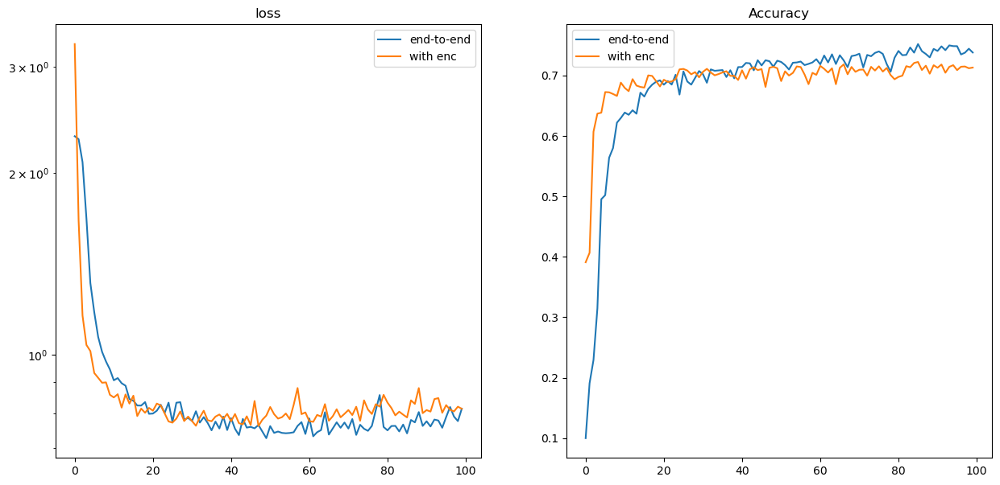

In [37]:
fig, axs = plt.subplots(1, 2, figsize=(15, 7))
axs[0].plot(val_losses_full, label="end-to-end")
axs[0].plot(val_losses_enc, label="with enc")
axs[0].set_yscale("log")
axs[0].set_title("loss")
axs[0].legend()

axs[1].plot(val_accs_full, label="end-to-end")
axs[1].plot(val_accs_enc, label="with enc")
axs[1].set_title("Accuracy")
axs[1].legend()

**Autoencoders** can be used to solve a variety of different tasks!


*   Denoising images: add random noise to the training transform and want to predict the denoised image
*   Filling holes: add random holes in the image and predict the filled image
*   Image Generation: via Variational Autoencoders VAEs,...

